In [6]:
from IPython.core.display import display, HTML, Javascript
html_contents ="""
<!DOCTYPE html>
<html lang="en">
    <head>
    <style>
    
    .top_section{
        background-color: #a13d2d;
        color: black;
        font-family: Copperplate, Papyrus, fantasy;
        font-weight: 800;
        font-size: 25px;
        padding: 8px 14px;
        margin-bottom: 6px;
    }
    
    .section_title{
        background-color: #FF8C00;
        color: black;
        font-family: Copperplate, Papyrus, fantasy;
        font-weight: 600;
        font-size: 25px;
        padding: 6px 12px;
        margin-bottom: 5px;
    }
    .subsection_title{
        background: #FFD580;
        font-weight: 400;
        color: black;
        font-family: Copperplate, Papyrus, fantasy;
        font-size: 21px;
        padding: 6px 12px;
        margin-bottom: 0px;
    }
    .subsection_detail{
        background: #D3D3D3;
        font-weight: 300;
        color: black;
        font-family: Copperplate, Papyrus, fantasy;
        font-size: 18px;
        border: 1px solid #d7d7d7;
        padding: 1px 10px 2px;
        box-shadow: 1px 1px 2px 1px rgba(0,0,0,0.3);
        margin-bottom: 3px;
    }
    </style>
    </head>
    
</html>
"""

HTML(html_contents)

# Questions Bank
1. read data
2. Setting New Column Title and cleaning column
3. Find Maximum,Min Survey Time
4. Plot to see the outlier
5. Age Distribution of Kaggle Users
6. Average Time to Finish Survey by Age
7. Gender Distribution of Kaggle Users
8. Gender and Age
9. Country Distribution of Kaggle Users
10. Participants Around the World
11. Age Distribution by Country (2.2.3.1)


# <div class="top_section">1. Introduction</div>
- Hello fellow kagglers! In this notebook we're going to analyse the latest <span style="color:#00FFFF;"> kaggle </span>  user survey and by doing so we're going to get some insights.
- I'm planning to go through feature(question) by feature and take closer look those features to inspect their relationships with previous features. So it's gonna take a while to finish this notebook with all features involved. I'm planning to update it regulary whenever I have free time, I hope you like it!

- This notebook will consist of two main parts:
    - First part will be about a general look of a participant, we are going to find about an averega kaggle user.
    - In second part I plan to guide through more specialized parts of a data science with a randomly selected person from these instances we inspected in first part, this randomly selected imaginary character will be named <span style="color:#FF0000;;font-weight:bold"> Robert </span> don't ask why yet :) you'll get to know about him in second part and we will try to find best path for an aspiring data scientist...


- Let's get started...

# <div class="section_title">2. The Data</div>
<img src="https://i.imgur.com/UlXkI3O.png" style="height: 180; width: 100%; object-fit: cover;"/>

- It all begins with the data, without it we can't tell the story... Imagine beign a medieval bard, he needs to travel around to listen common folk stories, tavern by tavern, village by village and then create an epic to tell the tale. In essence we do similar thing, maybe it's not as cool as bards... Oh well...
- Altough our stories might not be that epic we still can create some cool stuff with the help of some stuff in our toolbelt.
- Finding and creating meaningful relationships between data points where people can't see at first look sounds like some kind of magic. With the right data and tools we can even forecast the future! How do you like them apples bards! 
- So story telling from the data what makes us unique in a way and that's what we going to do in rest of to notebook. We have the data, we have the tools and we have story to tell!

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import iplot, init_notebook_mode

from scipy import stats
from scipy.stats import norm

import matplotlib.gridspec as gridspec
from matplotlib.ticker import MaxNLocator

import re

import warnings
warnings.filterwarnings('ignore')

# setting some global config
plt.style.use('fivethirtyeight')
cust_color = ['#fdc029',
'#f7c14c',
'#f0c268',
'#e8c381',
'#dfc498',
'#d4c5af',
'#c6c6c6',
'#a6a6a8',
'#86868a',
'#68686d',
'#4b4c52',
'#303138',
'#171820',
]
plt.rcParams['figure.figsize'] = (16,9)
plt.rcParams['figure.dpi'] = 300
plt.rcParams["axes.grid"] = True
plt.rcParams["grid.color"] = cust_color[3]
plt.rcParams["grid.alpha"] = 0.5
plt.rcParams["grid.linestyle"] = '--'
plt.rcParams["font.family"] = "monospace"

plt.rcParams['axes.edgecolor'] = 'black'
plt.rcParams['figure.frameon'] = True
plt.rcParams['axes.spines.left'] = True
plt.rcParams['axes.spines.bottom'] = True
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.linewidth'] = 1.5

In [8]:
def one_hot_count(df: pd.DataFrame, values:list,text:str, colors=None, shift_text=200, x_freq=2000, title=None):
    df2= df.copy()
    for val in values:
        df2[text+val]=df2[text+val].fillna('unk')
        df2[text+val]=df2[text+val].apply(lambda x: x.strip())
        df2[text+val]=df2[text+val].map({val:1, 'unk':0})
    df2.columns = df2.columns.str.replace(text, '', regex=False)
    
    counts = {}
    for col in values:
        counts[col]=df2[col].sum()
    counts = pd.DataFrame.from_dict(counts, orient='index')
    
    fig, ax = plt.subplots(figsize=(16, 12))
    counts = counts.rename(columns={0: 'Count'}).sort_values(by='Count',ascending=False)
    sns.barplot(y=counts.index,
                    x=counts['Count'], palette=colors, edgecolor='black', saturation = 1.5, linewidth = 1.5)
    for n, i in enumerate(counts['Count']):    
        ax.text(counts['Count'][n]+shift_text, 
                n, #Y location
                s=f'{round(counts.Count[n]/len(df2)*100,1)}%', 
                va='center', 
                ha='right', 
                color='white', 
                fontsize=10,
                bbox=dict(boxstyle='round',facecolor=cust_color[-1], alpha=0.5))
    plt.xticks(np.arange(x_freq, len(df2)+1, x_freq))
    plt.title(title)
    plt.show()
    return df2

In [82]:
# Reading the Data
df = pd.read_csv('kaggle_survey_2021_responses.csv')
df.head()


,Time from Start to Finish (seconds),Q1,Q2,Q3,Q4,Q5,Q6,Q7_Part_1,Q7_Part_2,Q7_Part_3,...,Q38_B_Part_3,Q38_B_Part_4,Q38_B_Part_5,Q38_B_Part_6,Q38_B_Part_7,Q38_B_Part_8,Q38_B_Part_9,Q38_B_Part_10,Q38_B_Part_11,Q38_B_OTHER
0,Duration (in seconds),What is your age (# years)?,What is your gender? - Selected Choice,In which country do you currently reside?,What is the highest level of formal education ...,Select the title most similar to your current ...,For how many years have you been writing code ...,What programming languages do you use on a reg...,What programming languages do you use on a reg...,What programming languages do you use on a reg...,...,"In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor...","In the next 2 years, do you hope to become mor..."
1,910,50-54,Man,India,Bachelor’s degree,Other,5-10 years,Python,R,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,784,50-54,Man,Indonesia,Master’s degree,Program/Project Manager,20+ years,NaN,NaN,SQL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
3,924,22-24,Man,Pakistan,Master’s degree,Software Engineer,1-3 years,Python,NaN,NaN,...,NaN,NaN,TensorBoard,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,575,45-49,Man,Mexico,Doctoral degree,Research Scientist,20+ years,Python,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN


In [83]:
# Setting New Column Title
df.columns = df.iloc[0]
df = df[1:]

#cleaning
df.columns= df.columns.str.replace('- selected choice', '')
df.columns = df.columns.str.replace(r'\(select all the apply\) -', '')


df.head()



,Duration (in seconds),What is your age (# years)?,What is your gender? - Selected Choice,In which country do you currently reside?,What is the highest level of formal education that you have attained or plan to attain within the next 2 years?,Select the title most similar to your current role (or most recent title if retired): - Selected Choice,For how many years have you been writing code and/or programming?,What programming languages do you use on a regular basis? (Select all that apply) - Selected Choice - Python,What programming languages do you use on a regular basis? (Select all that apply) - Selected Choice - R,What programming languages do you use on a regular basis? (Select all that apply) - Selected Choice - SQL,...,"In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - Comet.ml","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - Sacred + Omniboard","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - TensorBoard","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - Guild.ai","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - Polyaxon","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - ClearML","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - Domino Model Monitor","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - MLflow","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - None","In the next 2 years, do you hope to become more familiar with any of these tools for managing ML experiments? (Select all that apply) - Selected Choice - Other"
1,910,50-54,Man,India,Bachelor’s degree,Other,5-10 years,Python,R,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,784,50-54,Man,Indonesia,Master’s degree,Program/Project Manager,20+ years,NaN,NaN,SQL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
3,924,22-24,Man,Pakistan,Master’s degree,Software Engineer,1-3 years,Python,NaN,NaN,...,NaN,NaN,TensorBoard,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,575,45-49,Man,Mexico,Doctoral degree,Research Scientist,20+ years,Python,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,None,NaN
5,781,45-49,Man,India,Doctoral degree,Other,< 1 years,Python,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


* Ok we just geared our toolbelt and loaded the dataset, let's inspect it column by column to see if we can come up with something...

# <div class="section_title">2.1 Survey Duration</div>

- We do have the statistics of how much time (in seconds) has user been interacting with the questions and answering them. Maybe we can find some interesting stuff?
- A good rule of thumb is to aim for a survey takes no more than 15 to 20 minutes to complete, usually shorter than that.
- Let's take a look some basic aggregations to see if that's the case with kaggle survey too.

In [78]:
# changing dtype to in for numerical aggregations and finfd max
df['Duration (in seconds)'] = df['Duration (in seconds)'].astype(int)
mx = df['Duration (in seconds)'].max()
print(f'Maximum survey time')


Maximum Survey Time: 2488653 seconds.


- It looks like we have some outliers, because some user spent almost 700 hours on the survey! I mean he/she can be really indecisive but let's be real here, it probably caused by a system error or maybe someone took a reaaaaaly long coffee break, we all need some rest, right?..
- I'm going to clip values bigger than 10000 seconds to see if it gets better.

In [11]:
def plot_dist3(df, feature, title, clip_value):
    
    # Creating a customized chart. and giving in figsize and everything.
    
    fig = plt.figure(constrained_layout=True)
    
    # creating a grid of 3 cols and 3 rows.
    
    grid = gridspec.GridSpec(ncols=3, nrows=2, figure=fig)

    # Customizing the histogram grid.
    
    ax1 = fig.add_subplot(grid[0, :2])
    
    # Set the title.
    
    ax1.set_title('Histogram')
    
    # plot the histogram.
    
    sns.distplot(df.loc[:, feature].clip(0,clip_value),
                 hist=True,
                 kde=True,
                 fit=norm,
                  hist_kws={
                 'rwidth': 0.85,
                 'edgecolor': 'black',
                 'linewidth':.5,
                 'alpha': 0.8},
                 ax=ax1,
                 color=cust_color[0])
    
    ax1.axvline(df.loc[:, feature].clip(0,clip_value).mean(), color='Green', linestyle='dashed', linewidth=3)

    min_ylim, max_ylim = plt.ylim()
    ax1.text(df.loc[:, feature].clip(0,clip_value).mean()*1.25, max_ylim*0.85, 'Mean: {:.2f}'.format(df.loc[:, feature].clip(0,clip_value).mean()), color='Green', fontsize='12',
             bbox=dict(boxstyle='round',facecolor='red', alpha=0.5))
    ax1.legend(labels=['Actual','Normal'])
    ax1.xaxis.set_major_locator(MaxNLocator(nbins=12))
    
    
    ax1.annotate(
    # Label and coordinate
    'Unexpected Spike here!', xy=(10000, 0.00025),xytext=(10500, 0.0004) ,
    horizontalalignment="center",
    # Custom arrow
    arrowprops=dict(arrowstyle='simple',lw=1, color='black'), fontsize=8
    )

    # customizing the QQ_plot.
    
    ax2 = fig.add_subplot(grid[1, :2])
    
    # Set the title.
    
    ax2.set_title('Probability Plot')
    
    # Plotting the QQ_Plot.
    stats.probplot(df.loc[:, feature].clip(0,clip_value),
                   plot=ax2)
    ax2.get_lines()[0].set_markerfacecolor('#e74c3c')
    ax2.get_lines()[0].set_markersize(12.0)
    ax2.xaxis.set_major_locator(MaxNLocator(nbins=16))

    # Customizing the Box Plot:
    
    ax3 = fig.add_subplot(grid[:, 2])
    # Set title.
    
    ax3.set_title('Box Plot')
    
    # Plotting the box plot.
    
    sns.boxplot(y=feature, data=df, ax=ax3, color=cust_color[0])
    ax3.yaxis.set_major_locator(MaxNLocator(nbins=24))
    ax3.set_ylim(0,clip_value)

    plt.suptitle(f'{title}', fontsize=24, fontname = 'monospace', weight='bold')

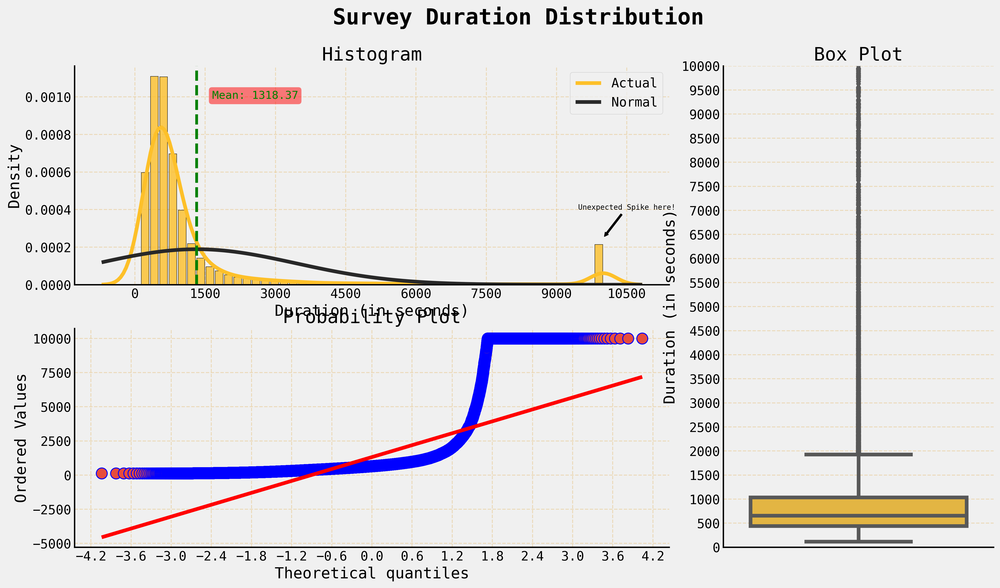

In [12]:
plot_dist3(df, 'Duration (in seconds)', 'Survey Duration Distribution', 10000)

- Looks much better! We can see that most of the users finished their answering under 20 minutes, which fits to rule of thumb I mentioned above. We still have some outliers but they look more humane levels to me...
- On average survey took around 20 minutes where most of the users were done in 10-15 minutes...
- By looking at the probability plot we can see that data doesn't follow the normal distribution. I know, I know you can already see that in histogram too :)

# <div class="section_title">2.2 Demographics</div>

- Thanks to kaggle for being available across the world easily and free we do have great demographic data to explore and that's what we're going to in next chapter...

# <div class="subsection_title">2.2.1 Age</div>
- In this part of the data we have age groups of participants,
- By looking at recent years trends and Data Science being labelled as one of the best jobs by some news sources I expect high number of young participants.
- With the all hype around data and data related jobs I expect to increased demand from employers and graduates with interest in kaggle.
- Let's see if data confirms my hypothesis...

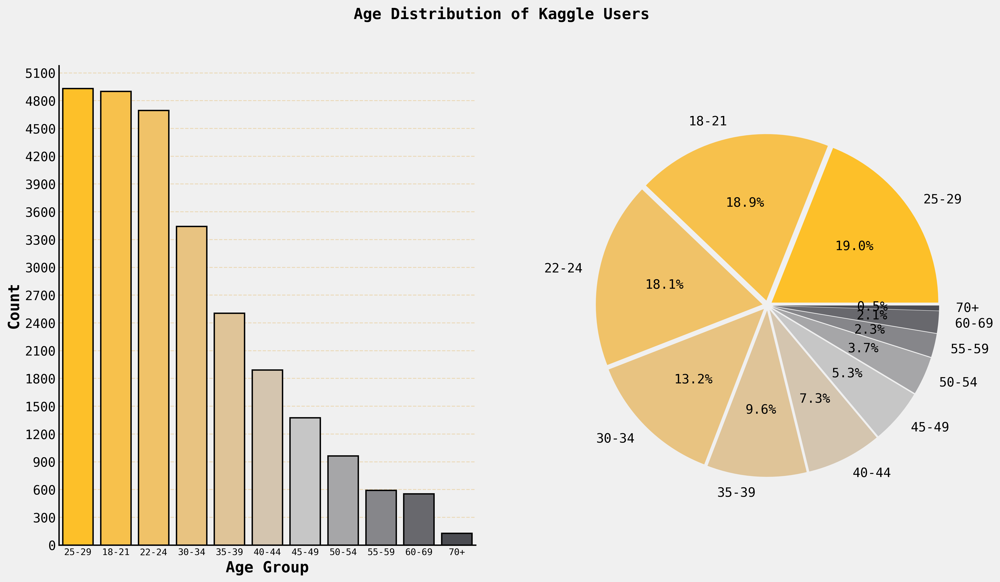

In [13]:
fig, ax = plt.subplots(1, 2)
sns.barplot(x=df['What is your age (# years)?'].value_counts().index, y=df['What is your age (# years)?'].value_counts().values, palette=cust_color, ax=ax[0],
           edgecolor='black', linewidth=1.5, saturation=1.5)
ax[0].yaxis.set_major_locator(MaxNLocator(nbins=20))
ax[0].tick_params(axis='x', which='major', labelsize=10)
ax[0].set_ylabel('Count', weight='semibold', fontname = 'monospace')
ax[0].set_xlabel('Age Group', weight='semibold', fontname = 'monospace')



ax[1].pie(df['What is your age (# years)?'].value_counts(), labels = df['What is your age (# years)?'].value_counts().index, colors = cust_color, autopct='%1.1f%%',
        explode=[0.03 for i in df['What is your age (# years)?'].value_counts().index])


plt.suptitle('Age Distribution of Kaggle Users', fontname = 'monospace', weight='bold')
plt.show()

- Please don't burn my plot to the ground because of the "Pie Chart", I know most of the people hates them, but I find them useful for small categories like this.
- Ok with leaving pie chart hate behind let's check the values we got, it seems my first instict is true; most of the participants are younger than 35 years old.
- And we can also see that 18-21 age group almost made it to top (0.1% difference), so the trend for data related jobs still going strong among students.
- By looking at the other side of the charts we see either really experienced users or people got interest in data science in late stages of their career, believe me it's never too late! It's nice to see couple hundred of them hanging around...

# <div class="subsection_detail">2.2.1.1 Survey Duration vs. Age</div>
- Maybe it's not that important to check this relationship but I got the curiosity to see if there is a meaningful relation between these two...

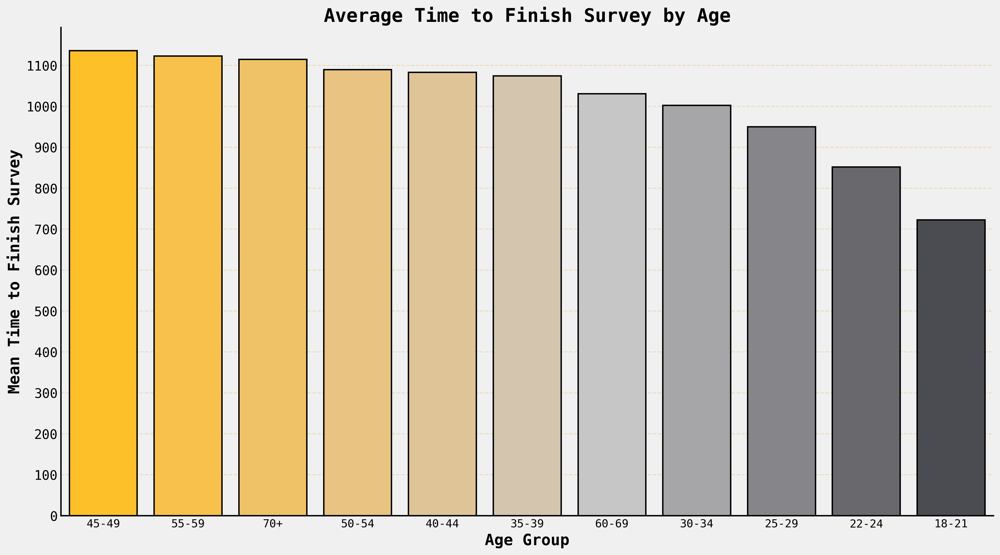

In [14]:
z=df[df['Duration (in seconds)']<10000].groupby('What is your age (# years)?')['Duration (in seconds)'].mean().sort_values(ascending=False)
sns.barplot(x=z.index, y=z.values, palette=cust_color, edgecolor='black', linewidth=1.5, saturation=1.5)

plt.xlabel("Age Group", fontname = 'monospace', weight='semibold')
plt.ylabel("Mean Time to Finish Survey", fontname = 'monospace', weight='semibold')
plt.title('Average Time to Finish Survey by Age', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12)
plt.yticks(np.arange(0, z.values.max()+1, 100))
plt.show()

- It looks like younger people tend to finish survey a little bit faster, or maybe experienced people are paying attention to details a little bit more, anyways no need to hurry eh? :) Let's get on the next demographic feature...


# <div class="subsection_title">2.2.2 Gender</div>
- While Data Science sector growing fast the male dominance still stands, that would be worrying if the trend keeps going incoming years. For some of the people it might not be a obvious problem but incresed bias in data related works might affect the outcomes of machine learning/ai predictions in near future. Let's take a look how're things stand for this subject on kaggle...

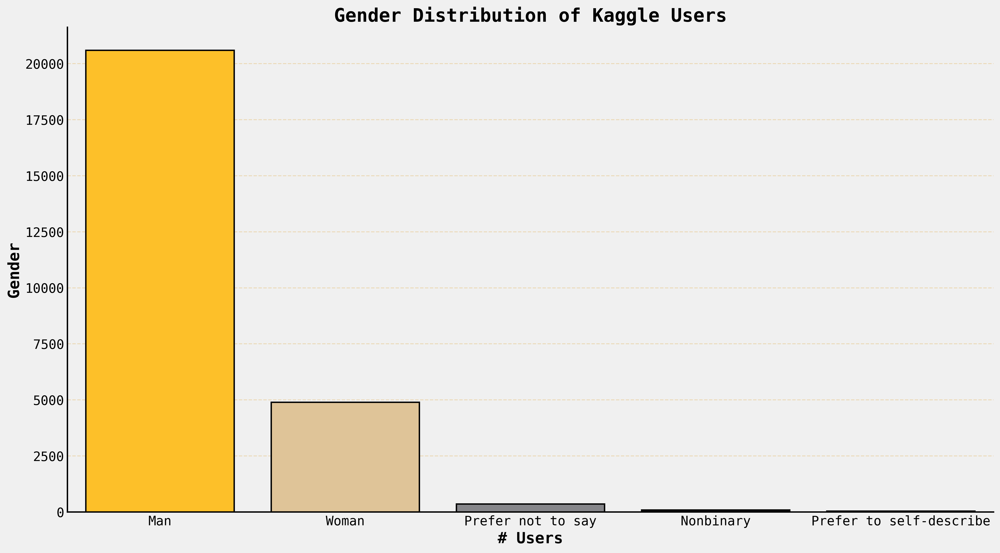

In [15]:
fig, ax = plt.subplots()
sns.barplot(x=df['What is your gender?'].value_counts().index, y=df['What is your gender?'].value_counts().values, palette=cust_color[::4], edgecolor='black', linewidth=1.5, saturation=1.5)
plt.xlabel("# Users", fontname = 'monospace', weight='semibold')
plt.ylabel("Gender", fontname = 'monospace', weight='semibold')
plt.title('Gender Distribution of Kaggle Users', fontname = 'monospace', weight='bold');

- Uhmm doesn't look much better than last year if I remember correctly, they stand around same like last year (~78%, ~19%). Maybe looking at some other relations with this data might help us to get better insights.

# <div class="subsection_detail">2.2.2.1 Age vs Gender</div>

In [16]:
# Plotting interactive sunburst:

fig = px.sunburst(data_frame=df,
                  path=['What is your gender?', 'What is your age (# years)?'],
                  color='What is your gender?',
                  color_discrete_sequence=cust_color[::-4],
                  title='Gender and Age'
                 )

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=40, l=0, r=0, b=0))
fig.show()

- Another Pie'ish looking chart right? I'm sorry but this one looks little bit cooler, wouldn't you agree :) Anyways;
- This one gives us a little bit better insight, by looking at age groups of dominant genders we can see that younger women are getting into data science/machine learning area a bit more than their counterparts.
- 18-21 age group takes 5% more in their gender group than males, again 22-24 is 2% more than men followed by 25-29 which again little bit bigger fraction in women than men.
- So by looking at percentages we would say younger women are getting into data science more and more, it's nice to have diversity among users in future!

In [17]:
def count_dist(df, colname=None, fixlabel=False, f_axis=None, fixlabel_n=None, fixlabel_txt=None, max_idx=30, fontsize=8, palette=cust_color, rotation=45,
              title='X distribution of Kaggle Users', y_label='', shift=-0.005):
    fig, ax = plt.subplots()
    sns.barplot(y=df[colname].value_counts().index[:max_idx],
                x=df[colname].value_counts().values[:max_idx], palette=palette, edgecolor='black', linewidth=1.5, saturation = 1.5)
    z=df[colname].value_counts().values[:max_idx]
    for n, i in enumerate(df[colname].value_counts().index[:max_idx]):    
        ax.text(df[colname].value_counts().values[:max_idx][n]+shift, 
                n, #Y location
                s=f'{round(z[n]/df.shape[0]*100,1)}%',                 
                va='center', 
                ha='right', 
                color='white', 
                fontsize=fontsize,
                bbox=dict(boxstyle='round',facecolor='black', alpha=0.5))
    if fixlabel:
        if f_axis == 'x':
            labels = [item.get_text() for item in ax.get_xticklabels()]
            labels[fixlabel_n] = fixlabel_txt
            ax.set_xticklabels(labels)
        else:
            labels = [item.get_text() for item in ax.get_yticklabels()]
            labels[fixlabel_n] = fixlabel_txt
            ax.set_yticklabels(labels)            

    plt.title(title, fontname = 'monospace', weight='bold')
    del z
    
    plt.yticks(fontsize=12,rotation=rotation)
    plt.xlabel("# Users", fontname = 'monospace', weight='semibold')
    plt.ylabel(y_label, fontname = 'monospace', weight='semibold')
    plt.show()

# <div class="subsection_title">2.2.3 Countries</div>
- Another interesting demographic statistic for me is the country where participants currently residing. Again thanks to kaggle's ease to access and global availability we have chance to see how's the data science community develops around the world.
- It's important to see equal growth around the world to build stronger community and wealth.
- First let's take a look top countries with highest number of participants:

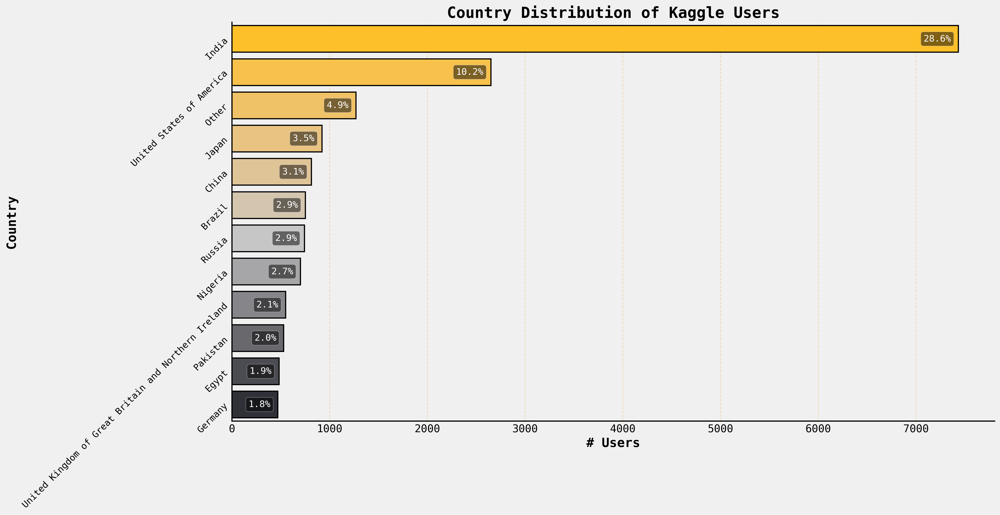

In [18]:
count_dist(df=df, colname='In which country do you currently reside?', max_idx=12, fontsize=12, rotation=45, title='Country Distribution of Kaggle Users', shift=-75, y_label = 'Country')

- Maybe plotting these values on World Map would be more visually satisfying and allows us to see wider perspective:

In [19]:
import plotly.offline as py
py.offline.init_notebook_mode()

def plot_in_map(locations,counts,title):
    data = [ dict(
            type = 'choropleth',
            locations = locations,
            z = counts,
            locationmode = 'country names',
            autocolorscale = True,
            marker = dict(
                line = dict(color = 'rgb(58,100,69)', width = 0.6)),
                colorbar = dict(autotick = True, tickprefix = '', title = '# of Kagglers')
                )
           ]

    layout = dict(
        title = title,
        geo = dict(
            showframe = True,
            showcoastlines = True,
            showocean = True,
            showlakes = True,
            oceancolor = '#00008B',
            projection = dict(
            type = 'robinson'
            ),
        margin = dict(b = 0, t = 0, l = 0, r = 0,pad= 5)
                ),
        autosize = True
        )

    fig = dict(data=data, layout=layout)
    
    py.iplot(fig, validate=False, filename='world-map')
z = df['In which country do you currently reside?'].value_counts()
plot_in_map(locations=z.index,
            counts=z.values,
            title='Participants Around the World')

- Looks like most of the participants are from Asia, led by India which keeps top spot in worldwide too.
- In Africa Nigeria, flag bearer of number of participants, followed by Egypt.
- North America's led by USA which also having global second place.
- In South America Brazil has the biggest community then comes Colombia.
- Europe looks much more balanced than rest of the world, if we don't count Austuralia (continent) :)

# <div class="subsection_detail">2.2.3.1 Age vs. Country</div>
- Here we're going to check age group frequencies of the given countries.
- It can give us insights about the where's the data science community grows with lots of young people getting interested in the field.

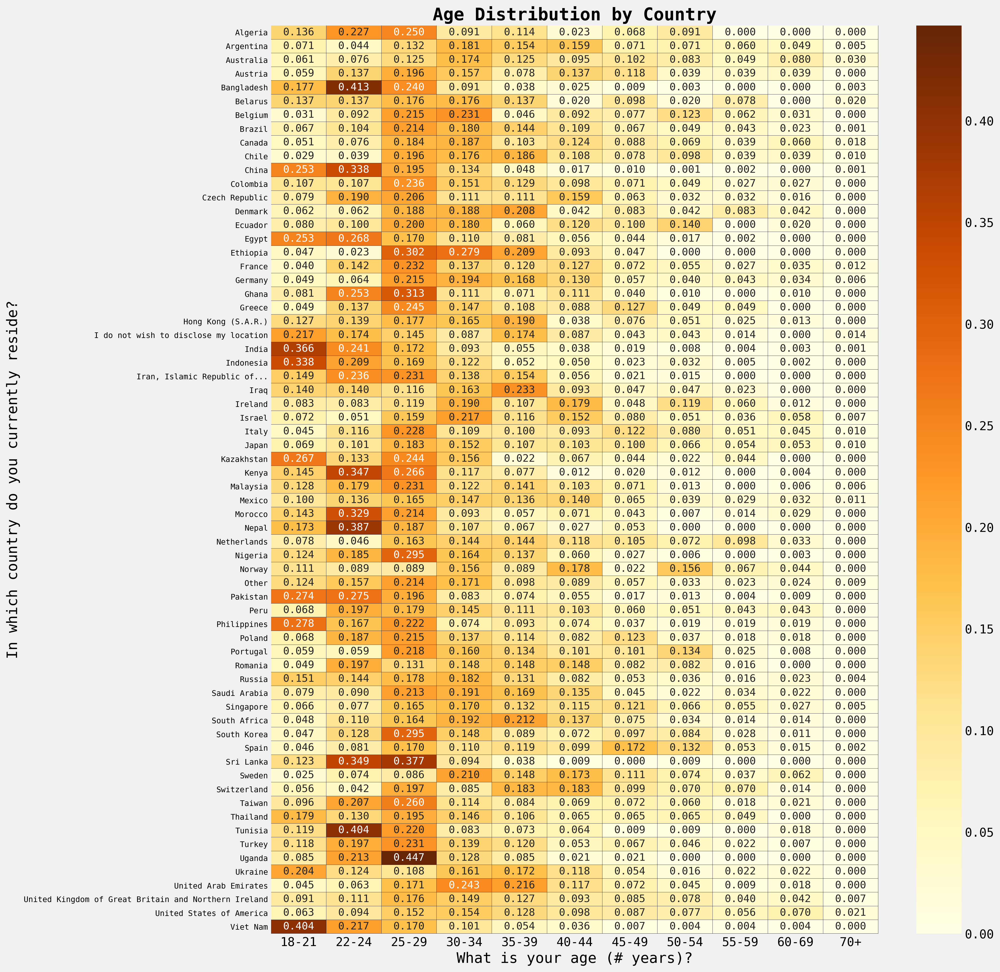

In [20]:
z=df.groupby([ 'In which country do you currently reside?', 'What is your age (# years)?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 18))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.3f')
plt.title('Age Distribution by Country', fontname = 'monospace', weight='bold')
plt.yticks(fontsize=9)
plt.show()
del z

- I see that countries like Viet Nam, India, Indonesia, Bangladesh are having high number of young people are interested in field with bigger portion of their participants are younger than 25. 
- Meanwhile countries from Europe, Arabian Peninsula, North East Asia, North America are getting little older in average age distribution. I wouldn't say surely without data but my inner instincts saying there could be two/three reasons for this:
 * These countries adopted data science education earlier and already have experienced people.
 * People moving abroad to bigger companies clustered in some countries after getting experienced in their countries.
 * Or some countries has really big population growth and interest in data science is common among the studends.
- Hmm which one it could be...

<img src="https://i.imgur.com/g1NCcmc.png" style="height: 180; width: 100%; object-fit: cover;"/>

# <div class="subsection_detail">2.2.3.2 Gender vs. Country</div>

- While it's important to have diversity among the countries it's also important to have similar diversity between genders too, let's see if we can see different results in that regards...

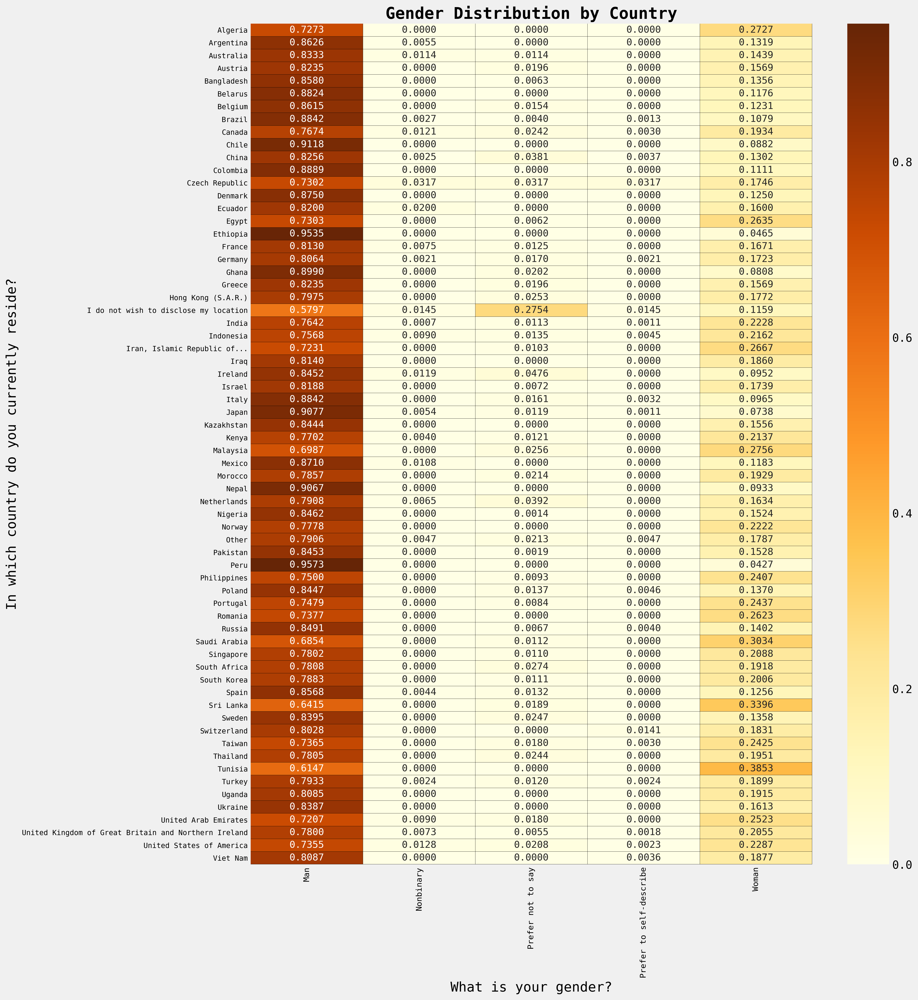

In [21]:
z=df.groupby([ 'In which country do you currently reside?', 'What is your gender?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 18))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Gender Distribution by Country', fontname = 'monospace', weight='bold')
plt.yticks(fontsize=9)
plt.xticks(fontsize=10)
plt.show()
del z

- Hmm, looks like general trend with global gender distribution is about the same with countries too.
- You can also notice that people who prefer not to share their gender also likely to don't share their location than others too, I respect their privacy :)

# <div class="subsection_title">2.2.4 Education</div>

- Level of education is a hot topic in data science machine/machine learning field. Some believe you need a master's degree at least, some claims it's unnecessary. Each on his own I guess, but most people think getting higher degree in field comes with specialized knowledge, career advancements, increased earnings etc, at the end it's your career choice.
- Now let's listen the story that numbers going to tell us, my hypothesis is either bachelor's or master's going to take first place by looking at age distribution we checked while ago...

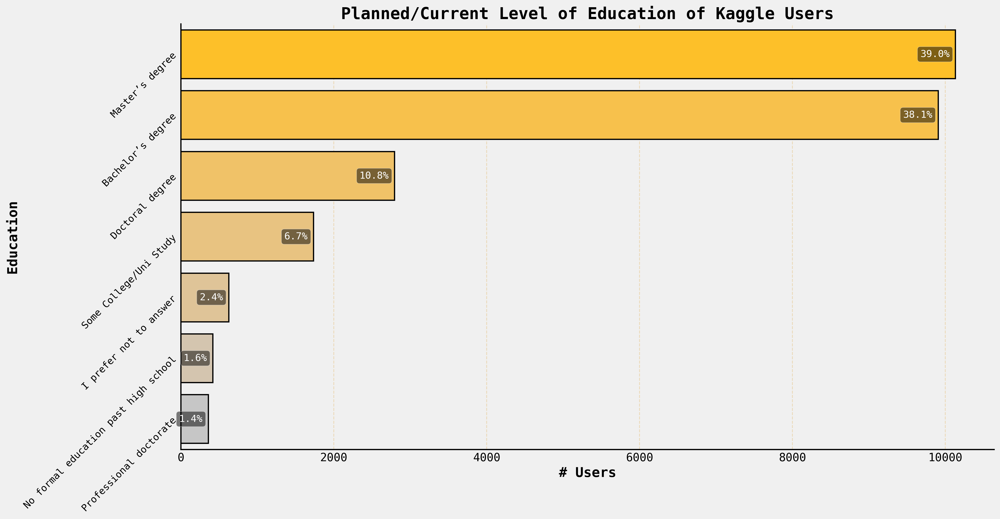

In [22]:
count_dist(df=df, colname='What is the highest level of formal education that you have attained or plan to attain within the next 2 years?', max_idx=14, fontsize=12,
           rotation=45, fixlabel=True, f_axis='y', fixlabel_n=3, fixlabel_txt='Some College/Uni Study',
           title='Planned/Current Level of Education of Kaggle Users', palette=cust_color, shift=-75, y_label= 'Education')

- Looks like my hypothesis was right. Most of the participants are already have master's degree or planning to get one in next two years, that includes me too :)
- By looking at the plot we can see bachelor's and master's are almost at same level, what I wonder is what percentage of master's degree option are actually having that degree or they are just plan to attain. Maybe we can find some insights with future features we dig into but for now we can use age attribute.

# <div class="subsection_detail">2.2.4.1 Education vs Age</div>

- Let's take a closer look to these two degrees with age involved, if we can see something.

In [23]:
# Plotting interactive sunburst:

fig = px.sunburst(data_frame=df[(df['What is the highest level of formal education that you have attained or plan to attain within the next 2 years?']=="Master’s degree")|
                               (df['What is the highest level of formal education that you have attained or plan to attain within the next 2 years?']=="Bachelor’s degree")],
                  path=['What is your age (# years)?', 'What is the highest level of formal education that you have attained or plan to attain within the next 2 years?'],
                  color='What is the highest level of formal education that you have attained or plan to attain within the next 2 years?',
                  color_discrete_sequence=cust_color[::-2],
                  title="Age groups of Master's and Bachelor's degrees"
                 )

fig.update_traces(textinfo='label+percent parent')
fig.update_layout(margin=dict(t=40, l=0, r=0, b=0))
fig.show()

- Well it doesn't look like anything to me :) It looks like what it should be looking like, with just little maybe at the age group of 18-21 having some participants master's degree plans, we would assume they are older than 20? Actually it depends on education starting age and education system for specific country so we can't be sure...
- Anyways let's take look at bigger picture with heatmap:

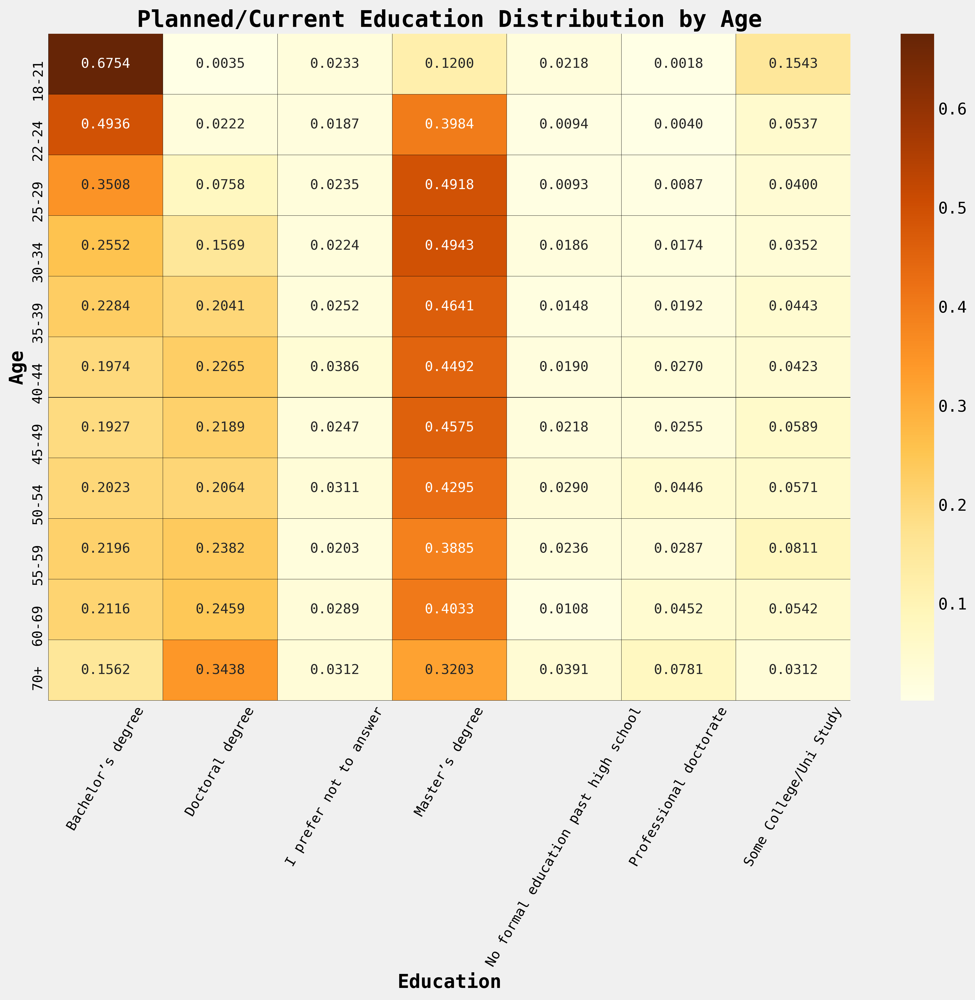

In [24]:
z=df.groupby(['What is your age (# years)?','What is the highest level of formal education that you have attained or plan to attain within the next 2 years?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 10))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Planned/Current Education Distribution by Age', fontname = 'monospace', weight='bold')
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[-1] = 'Some College/Uni Study'
ax.set_xticklabels(labels)
plt.xticks(fontsize=12, rotation=60)
plt.yticks(fontsize=12)
plt.xlabel("Education", fontname = 'monospace', weight='semibold')
plt.ylabel("Age", fontname = 'monospace', weight='semibold')
plt.show()
del z

- We can observe that most popular education level starts with bachelor's degree at the age 18 till 24,
- Then master's degree taking the lead for big chunk of age groups untill 70+ where doctoral degree taking first place at that point.
- **Special spot for the people who are attending/planning(next 2 years) Doctoral/Professional doctorate degree at the age of 18-21, taking 0.0053% of the age group, you are the real champions :))**

# <div class="subsection_detail">2.2.4.2 Education vs Country</div>

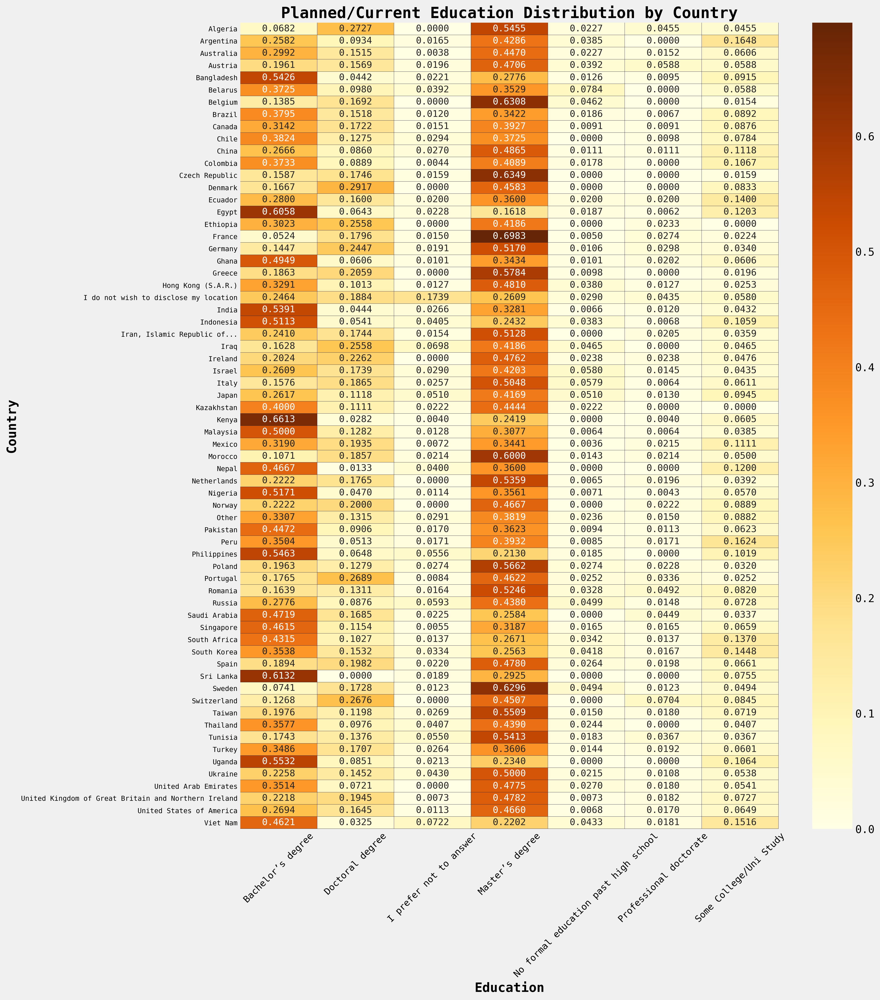

In [25]:
z=df.groupby(['In which country do you currently reside?','What is the highest level of formal education that you have attained or plan to attain within the next 2 years?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 18))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Planned/Current Education Distribution by Country', fontname = 'monospace', weight='bold')
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[-1] = 'Some College/Uni Study'
ax.set_xticklabels(labels)
plt.xticks(fontsize=12,rotation=45)
plt.yticks(fontsize=9)
plt.xlabel("Education", fontname = 'monospace', weight='semibold')
plt.ylabel("Country", fontname = 'monospace', weight='semibold')
plt.show()
del z

- Highest master's degree ratio goes to France, which makes sense since 25-29 age group has the biggest percentage in France if you recall from Age chapter and Master's Degree is the most popular one among age 25-29 group globally...
- Highes doctoral goes for Denmark, again their age group for country and education looks correlated.
- In general these Age-Country-Education relation seems solid but still hypothetical, because there are some countries where this trend doesn't fit, like Uganda; this might due to low number of participants.
- Maybe looking at countries where number of participants greater/less than a threshold would be clearer:

In [26]:
df['edu_cnt'] = df.groupby('What is the highest level of formal education that you have attained or plan to attain within the next 2 years?')['What is the highest level of formal education that you have attained or plan to attain within the next 2 years?'].transform('count')
df['ctr_cnt'] = df.groupby('In which country do you currently reside?')['In which country do you currently reside?'].transform('count')
df['What is the highest level of formal education that you have attained or plan to attain within the next 2 years?'].replace({'Some college/university study without earning a bachelor’s degree':'Some Uni Degrees'}, inplace=True)
fig = px.treemap(df[df['ctr_cnt']>df['ctr_cnt'].median()], path=[px.Constant("Countries"),'In which country do you currently reside?',
                                                                 'What is your age (# years)?',
                                                                 'What is the highest level of formal education that you have attained or plan to attain within the next 2 years?'],
                 values='edu_cnt', color='In which country do you currently reside?',
                 color_discrete_sequence=cust_color[::2],
                 title="Country-Age-Education Distribution for Countries With High Number of Participants")
fig.update_traces(textinfo='label+percent parent')
fig.show()

In [27]:
fig = px.treemap(df[df['ctr_cnt']<50], path=[px.Constant("Countries"),'In which country do you currently reside?',
                                                                 'What is your age (# years)?',
                                                                 'What is the highest level of formal education that you have attained or plan to attain within the next 2 years?'],
                 values='edu_cnt', color='In which country do you currently reside?',
                 color_discrete_sequence=cust_color[::2],
                 title="Country-Age-Education Distribution for Countries With Low Number of Participants")
fig.update_traces(textinfo='label+percent parent')
fig.show()

**Note:** You can click on specific tree to see detailed results or hover over them to get better info.

# <div class="subsection_detail">2.2.4.3 What About Courses?</div>

- As we all know the demand for a data scientist is on the rise.
- Students with analytical talents are getting more and more attracted to career in a data science field.
- But usually formal education is not enough or person changing his field without getting another formal education.
- So you will need some specialized techical education in order to get more data centric roles.
- This brings us to the courses, selecting a right course might help your career a lot!
- Let's see what course platforms are popular among kaggle users.

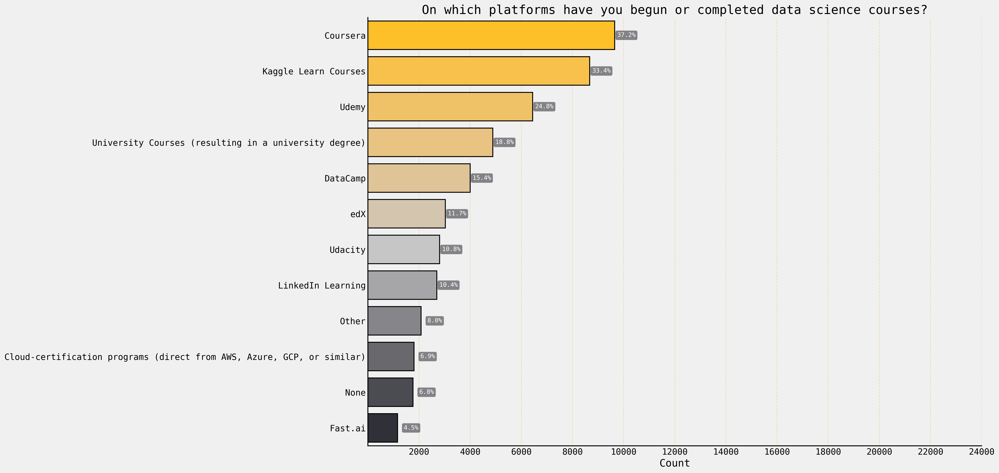

In [28]:
course_cols = [col.split('?')[-1].strip() for col in df.columns if "data science courses" in col]
crs=one_hot_count(df=df, values=course_cols, text="On which platforms have you begun or completed data science courses? ", colors=cust_color, shift_text=820, x_freq=2000,
                 title="On which platforms have you begun or completed data science courses?")

- Looks interesting... We do have some leaders like Coursera or Kaggle but still we don't have a clear winner.
- Let's see the effects of courses on other features.

# <div class="subsection_detail">2.2.4.3.1 Formal Education vs Courses</div>

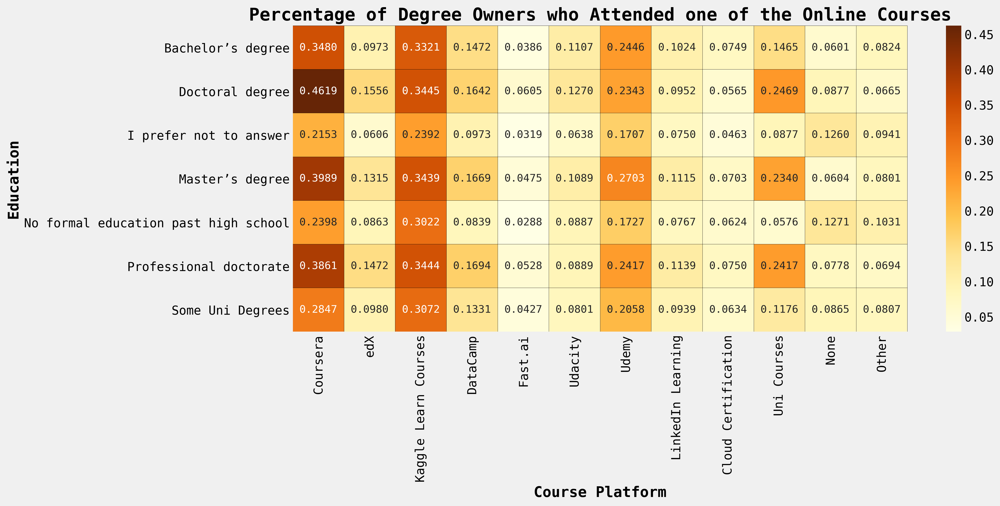

In [29]:
fig, ax = plt.subplots(figsize=(14, 6))
sns.heatmap(crs.groupby('What is the highest level of formal education that you have attained or plan to attain within the next 2 years?').mean().iloc[:,1:-2],
            xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Percentage of Degree Owners who Attended one of the Online Courses', fontname = 'monospace', weight='bold')
plt.ylabel('Education', fontname = 'monospace', weight='semibold')
plt.xlabel('Course Platform', fontname = 'monospace', weight='semibold')
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[-3] = 'Uni Courses'
labels[-4] = 'Cloud Certification'
ax.set_xticklabels(labels)
plt.show()

- Well, we can see the importance of online learning from the table above.
- Higher person gets formal education there is higher chance that the took one or more online courses for data science.
- Of course there is time effect on the hypothesis above but still it shows you something for future: Learning never stops in data field!

# <div class="subsection_title">2.2.5 Job / Role</div>

- Ah yes... Another hot topic in data related field, the title... There are really slim differences between some roles or sometimes people are using more inclusionary titles because they do several aspects of the job, like someone doing both data engineering and machine learning. What's his title then? A data engineer? or machine learning engineer? It's hard to answer sometimes, well at least for me :)
- Let's what we got here in survey, are specialized roles getting their place on top ranks or more generalized titles like data scientist going to take the lead.
- And we shouldn't forget about the age distribution of our data, we're going to have many students...

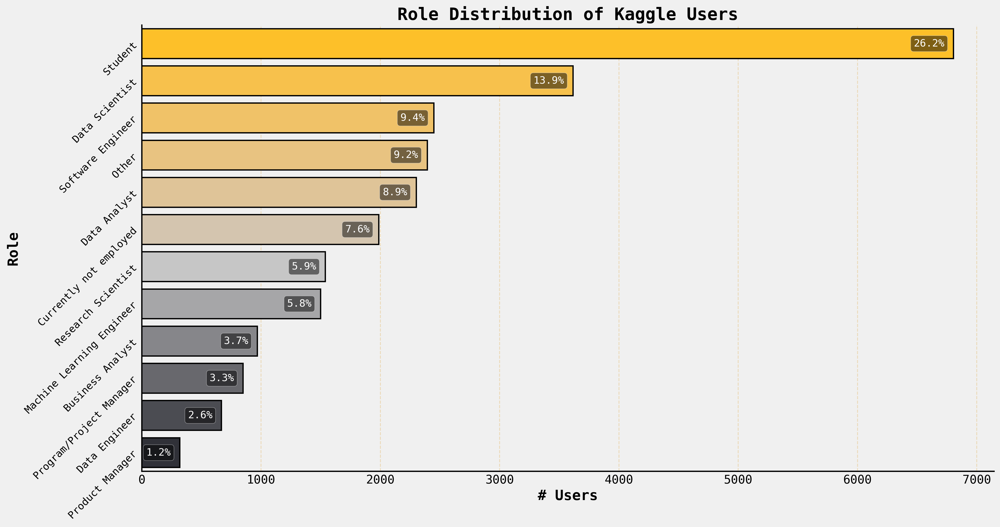

In [30]:
count_dist(df=df, colname='Select the title most similar to your current role (or most recent title if retired):',
           max_idx=12, fontsize=12, rotation=45, palette=cust_color,
           title='Role Distribution of Kaggle Users', shift=-75, y_label = 'Role'
          )

- Most common role is "Student" by big margin as expected and followed by fellow data scientists...
- By roles alone we can't say much at first look, everything looks what we expected like, we should check relations between this feature and others to see if we can get a better story.

# <div class="subsection_detail">2.2.5.1 Role vs. Age</div>

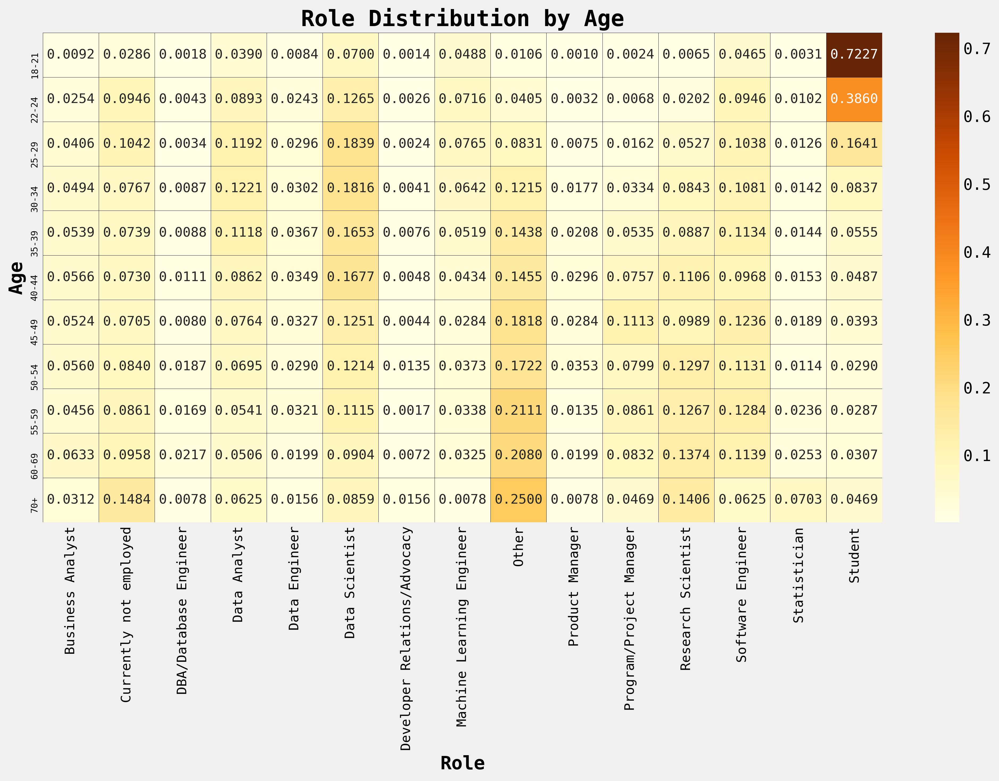

In [31]:
z=df.groupby(['What is your age (# years)?',
              'Select the title most similar to your current role (or most recent title if retired):']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 10))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Role Distribution by Age', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12,rotation=90)
plt.yticks(fontsize=8)
plt.xlabel("Role", fontname = 'monospace', weight='semibold')
plt.ylabel("Age", fontname = 'monospace', weight='semibold')
plt.tight_layout()
del z

- We see that most of the younger people are still studens, who would have expected that right!? Haha...
- Anyways, we can see that more the participant gets older more he/she get specialized role.
- You can see what I mean above by looking at "Other" role on X axis, percentages almost increasing consistently by age.
- On the other hand we can also observe that data science is still growing field where fraction of data scientists are going down with the age...

# <div class="subsection_detail">2.2.5.2 Role vs. Country</div>

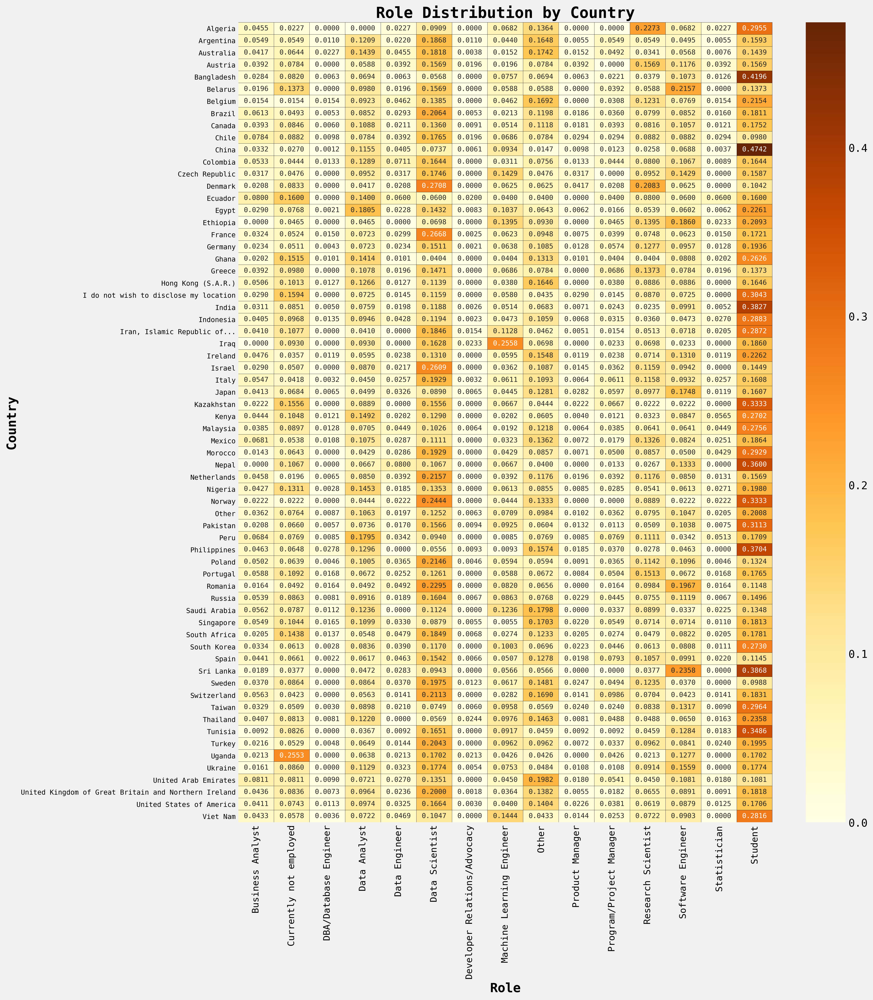

In [32]:
z=df.groupby(['In which country do you currently reside?',
              'Select the title most similar to your current role (or most recent title if retired):']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 18))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":9}, fmt='.4f')
plt.title('Role Distribution by Country', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12,rotation=90)
plt.yticks(fontsize=9)
plt.xlabel("Role", fontname = 'monospace', weight='semibold')
plt.ylabel("Country", fontname = 'monospace', weight='semibold')
plt.show()
del z

- Here we can see roles are mainly occupied by "Student" for most countries. It was expected since most of the participants are students.
- Some countries almost having 50% of their participants as students like China and Banglades, followed by India and Sri Lanka
- These numbers are cool but again we don't have balanced distribution for countries so what I wonder is how are the roles are spread when we count total number of users from countries.
- This might give us how are the data related role field is developing across the world.

# <div class="subsection_detail">2.2.5.3 Role vs. Country Round Two</div>

In [33]:
x=df.groupby(['In which country do you currently reside?',
              'Select the title most similar to your current role (or most recent title if retired):']).size().unstack().fillna(0).astype('int16')
x =x.apply(lambda x: x/x.sum(), axis=1)
z=x.std(axis=1).sort_values().reset_index().rename(columns={0: 'std'})
df['cnt_count'] = df.groupby('In which country do you currently reside?')['In which country do you currently reside?'].transform('count')
z = z.merge(df[['cnt_count', 'In which country do you currently reside?']], how='left', on='In which country do you currently reside?')
z.drop_duplicates(inplace=True)
df.drop('cnt_count', axis=1, inplace=True)

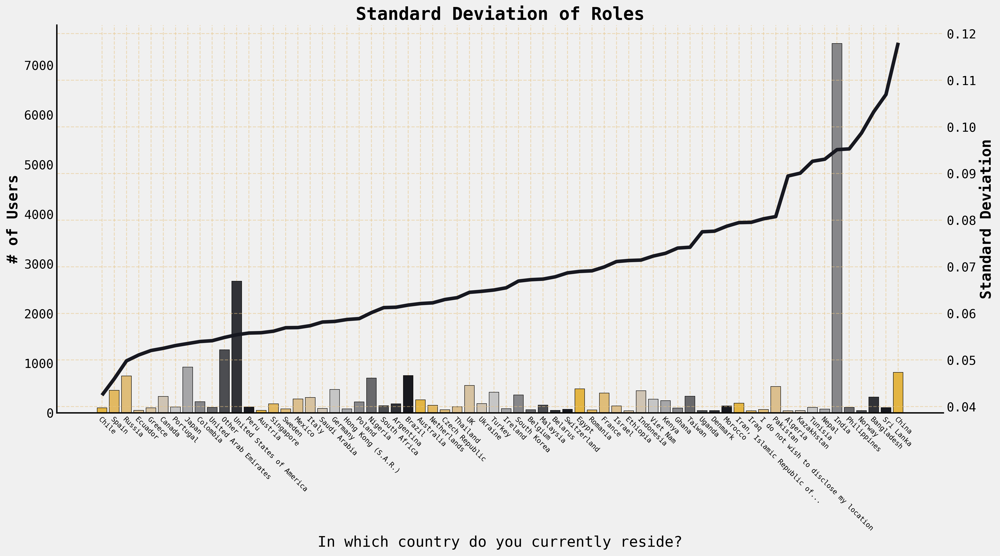

In [34]:
fig, ax = plt.subplots()
sns.barplot(x="In which country do you currently reside?", y="cnt_count", data=z, palette=cust_color, edgecolor='black')
ax2 = ax.twinx()
ax.grid(None)
sns.lineplot(data=z, x="In which country do you currently reside?", y="std", color=cust_color[-1])
fig.autofmt_xdate(rotation=90)
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[30] = 'UK'
ax.set_xticklabels(labels)
ax.xaxis.set_tick_params(labelsize=8)
plt.setp( ax.xaxis.get_majorticklabels(), rotation=-45, ha="left", rotation_mode="anchor") 
plt.title('Standard Deviation of Roles', fontname = 'monospace', weight='bold')
ax.set_ylabel("# of Users", fontname = 'monospace', weight='semibold')
ax2.set_ylabel("Standard Deviation", fontname = 'monospace', weight='semibold')
fig.tight_layout()

- That's more like it! When we include Standard Deviation of role percentages per country and total participants from that country it gives us some more meaningful story, well at least that's what I thought :/
- So, on X axis we have the countries, left-y axis is total number of participants and on right side we have std values for roles of that country.
- On the right side of the X axis we can see the countries where roles are away from normal distribution, this can be caused by couple reasons like:
    - There is a rush/hype for specific role and if demand is not enough (especially for students) it might cause some problems in future.
    - Or there isn't many participants to fill every role with healthy distribution, like Norway, we can spot them if they have small bars on plot...
- Left side shows more healthy growth in my opinion, roles somewhat get's saturated after some time, with increasing experince etc...

# <div class="subsection_detail">2.2.5.3 Education vs. Role</div>

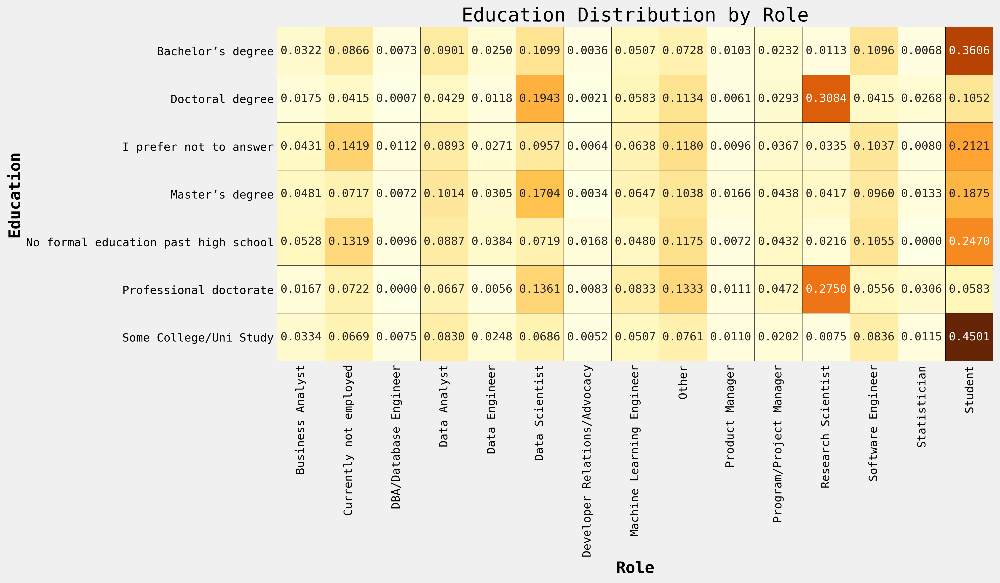

In [35]:
z=df.groupby(['What is the highest level of formal education that you have attained or plan to attain within the next 2 years?',
              'Select the title most similar to your current role (or most recent title if retired):']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, square=True, cbar=False, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Education Distribution by Role')
labels = [item.get_text() for item in ax.get_yticklabels()]
labels[-1] = 'Some College/Uni Study'
ax.set_yticklabels(labels)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlabel('Role', fontname = 'monospace', weight='semibold')
plt.ylabel('Education', fontname = 'monospace', weight='semibold')
plt.show()
del z

- Hmm this one above seems interesting... It looks like to me some students couldn't decide between if they should select choose Bachelor's Degree or Some College Study?

# <div class="subsection_detail">2.2.5.4 Courses vs. Role</div>

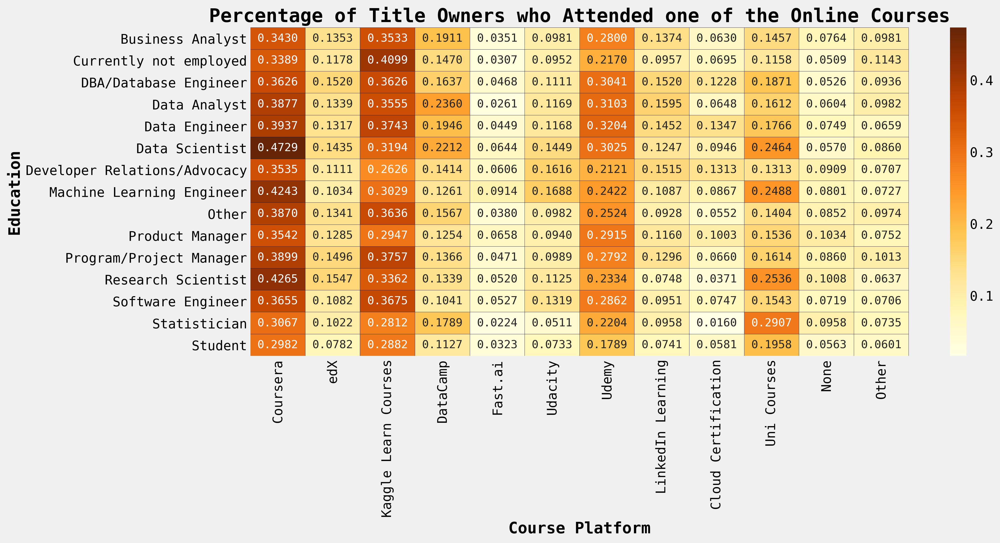

In [36]:
fig, ax = plt.subplots(figsize=(14, 6))
sns.heatmap(crs.groupby('Select the title most similar to your current role (or most recent title if retired):').mean().iloc[:,1:-2],
            xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Percentage of Title Owners who Attended one of the Online Courses', fontname = 'monospace', weight='bold')
plt.ylabel('Education', fontname = 'monospace', weight='semibold')
plt.xlabel('Course Platform', fontname = 'monospace', weight='semibold')
labels = [item.get_text() for item in ax.get_xticklabels()]
labels[-3] = 'Uni Courses'
labels[-4] = 'Cloud Certification'
ax.set_xticklabels(labels)
plt.show()

- Again like education, it doesn't matter what level you're on, you still could use help of online courses.
- We can clearly see decent amount of people who already has specialized titles attended an online course in past or still attending.

# <div class="section_title">2.3 Programming Languages</div>
- Another important topic for data field, what language a person should learn before he gets into data science. Which one is more practical, what if you need to access databases, do you want to do more comprehensive statistical analysis or what if do you want to see increased speed... Python, SQL, R, C/C++?
- All of these would have have different answers depending on person itself, his background, experience, work needs etc.
- In this chapter we going to take closer look to this part of the data science...

# <div class="subsection_title">2.3.1 Experience</div>

- Before getting on with languages themselves let's check how experienced the participants are with coding...

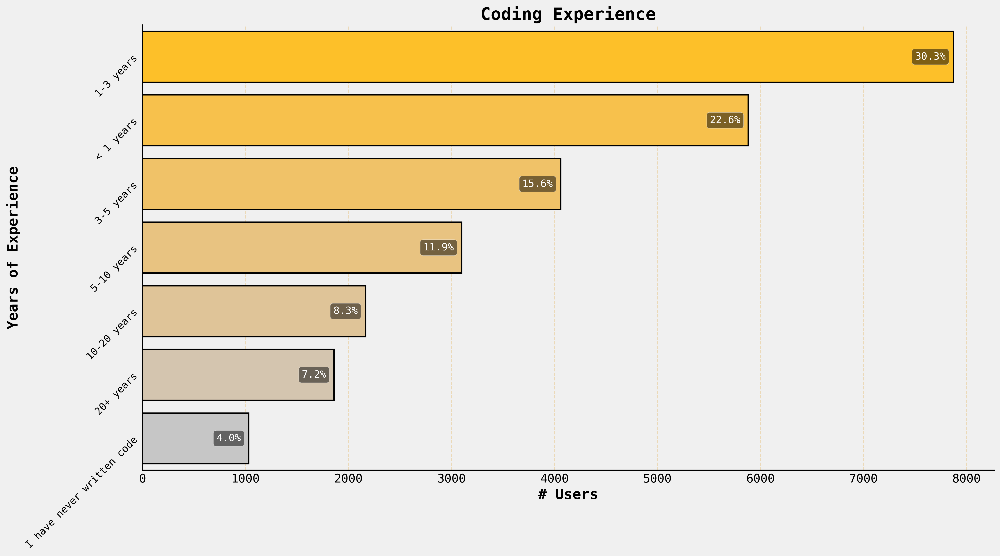

In [37]:
count_dist(df=df, colname='For how many years have you been writing code and/or programming?',
           max_idx=30, fontsize=12, rotation=45,
           title='Coding Experience', shift=-75, y_label='Years of Experience'
          )

- Most of the users has less than 3 years of coding experience, we could see that coming with amount of students from our previous charts, right?
- But we shouldn't underestimate amount of really experienced coders among participants, it seems they still do present reasonable part.
- Let's check how experience relates with other features of the users next...

# <div class="subsection_detail">2.3.1.1 Role vs. Experience</div>

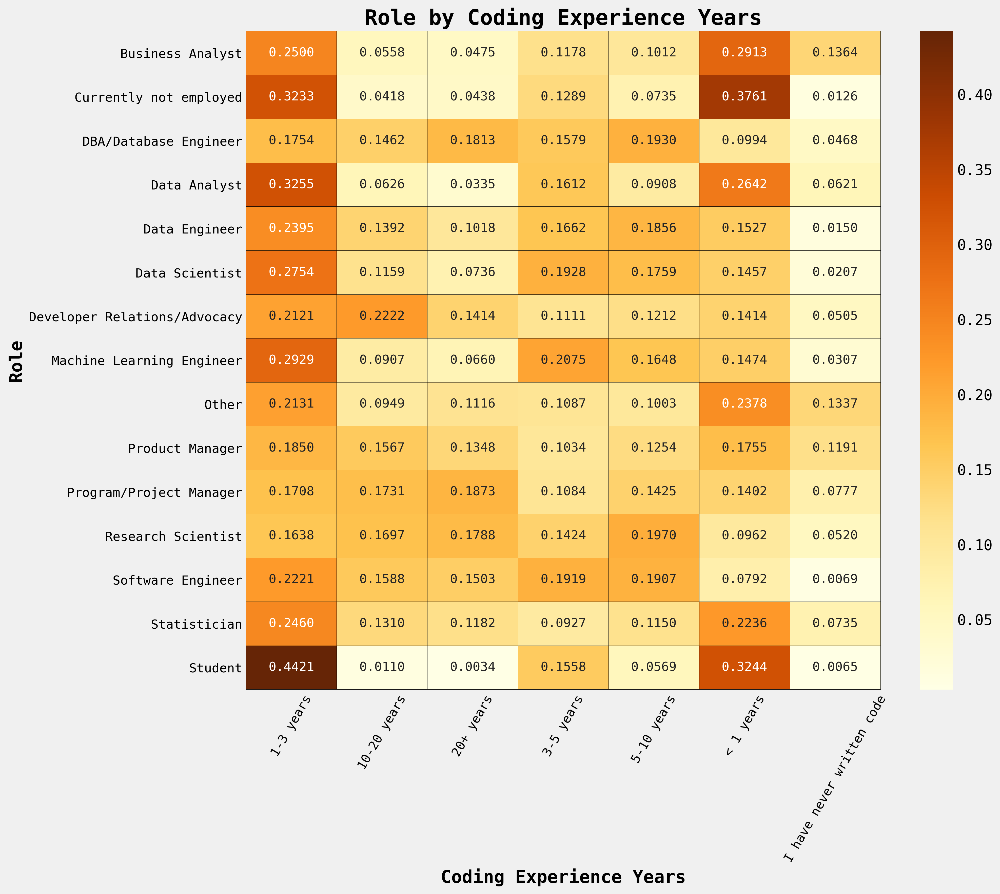

In [38]:
z=df.groupby(['Select the title most similar to your current role (or most recent title if retired):',
             'For how many years have you been writing code and/or programming?']).size().unstack().fillna(0).astype('int16')
fig, ax = plt.subplots(figsize=(14, 12))
sns.heatmap(z.apply(lambda x: x/x.sum(), axis=1), xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Role by Coding Experience Years', fontname = 'monospace', weight='bold')
plt.xticks(fontsize=12,rotation=60)
plt.yticks(fontsize=12)
plt.xlabel('Coding Experience Years', fontname = 'monospace', weight='semibold')
plt.ylabel('Role', fontname = 'monospace', weight='semibold')
plt.tight_layout()
del z

- Participants who never written code mostly are consists of business analysts, product managers and some various other roles.
- For under one year experience group, unemployed and students made a big jump, and some data related roles are somewhat closely distributed like ML Engineer, Data Scientist, Data Engineer etc.
- Next we have 1-3 years, which is the biggest group. 44% of students are in this group as they represent biggest role group among total participants too.
    - 1-3 years looks like a balanced group if we don't include the students. They take around ~20% of every single role group. There are roles at higher end of this average like Unemployed and Data Analysts...
- For the 3-10 years of experience range we can observe the beginning of drastic drops at some groups like Students, Unemployed, I believe that's the part where people start establishing their career path choices.
- 10+ years of experience groups where we can see lowest levels of unemployment and students.
    - Again we can see that Data Scientist, Machine Learning Engineer, Data Analyst roles are not popular among really experienced participants. This migt be due to:
        - Getting more managerial, advocacy roles with increased experience,
        - Experienced developers who interested in data science but havent changed their career path yet...
- Maybe merging this relation with one more layer would give us better insights:

# <div class="subsection_detail">2.3.1.1 Role, Education and Experience</div>

In [39]:
def genSankey(df,cat_cols=[],value_cols='',title='Sankey Diagram', colors=None):
    # Source: https://www.kaggle.com/iyadavvaibhav/plotly-sankey-with-filters    
    colorPalette = colors
    labelList = []
    colorNumList = []
    for catCol in cat_cols:
        labelListTemp =  list(set(df[catCol].values))
        colorNumList.append(len(labelListTemp))
        labelList = labelList + labelListTemp
        
    # remove duplicates from labelList
    labelList = list(dict.fromkeys(labelList))
    
    # define colors based on number of levels
    colorList = []
    for idx, colorNum in enumerate(colorNumList):
        colorList = colorList + [colorPalette[idx]]*colorNum
        
    # transform df into a source-target pair
    for i in range(len(cat_cols)-1):
        if i==0:
            sourceTargetDf = df[[cat_cols[i],cat_cols[i+1],value_cols]]
            sourceTargetDf.columns = ['source','target','count']
        else:
            tempDf = df[[cat_cols[i],cat_cols[i+1],value_cols]]
            tempDf.columns = ['source','target','count']
            sourceTargetDf = pd.concat([sourceTargetDf,tempDf])
        sourceTargetDf = sourceTargetDf.groupby(['source','target']).agg({'count':'sum'}).reset_index()
        
    # add index for source-target pair
    sourceTargetDf['sourceID'] = sourceTargetDf['source'].apply(lambda x: labelList.index(x))
    sourceTargetDf['targetID'] = sourceTargetDf['target'].apply(lambda x: labelList.index(x))
    
    # creating the sankey diagram
    data = dict(
        type='sankey',
        node = dict(
          pad = 15,
          thickness = 20,
          line = dict(
            color = "black",
            width = 0.5
          ),
          label = labelList,
          color = colorList
        ),
        link = dict(
          source = sourceTargetDf['sourceID'],
          target = sourceTargetDf['targetID'],
          value = sourceTargetDf['count']
        )
      )
    
    layout =  dict(
        title = title,
        font = dict(
          size = 10
        )
    )
       
    fig = dict(data=[data], layout=layout)
    
    return fig

In [40]:
df['edu_cnt'] = df.groupby('Select the title most similar to your current role (or most recent title if retired):')['Select the title most similar to your current role (or most recent title if retired):'].transform('count')
sank = genSankey(df,cat_cols=['What is the highest level of formal education that you have attained or plan to attain within the next 2 years?','For how many years have you been writing code and/or programming?','Select the title most similar to your current role (or most recent title if retired):'],value_cols='edu_cnt',title='Education, Experience and Role', colors = cust_color[::4])
fig = go.Figure(sank)
iplot(fig)

- Ok, looks little bit better,
- We can see with increased experience and education the more specialized roles are taken.
- Meanwhile most bachelor's and master's degrees are associated with less than 4 years of experience and mostly students...
- Connection between Master's degree and data scientist role gets little bit stronger with 3-5 years of experience than previous experience groups.


# <div class="subsection_title">2.3.2 The Languages</div>

In [41]:
languages = ['Python', 'R', 'SQL', 'C', 'C++', 'Java', 'Javascript', 'Julia', 'Swift', 'Bash', 'MATLAB', 'None', 'Other']

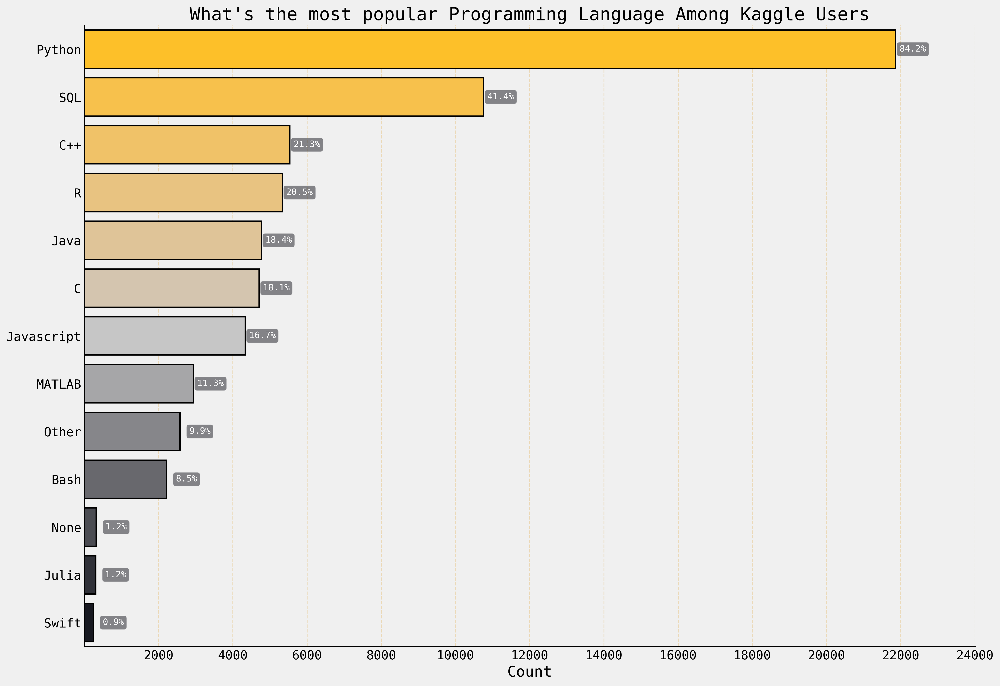

In [42]:
df2=one_hot_count(df=df, values=languages, text='What programming languages do you use on a regular basis? ', colors=cust_color, shift_text=825, x_freq=2000,
                 title="What's the most popular Programming Language Among Kaggle Users")

 - Python seems very popular among the Kaggle users more than twice as much than it's closest competitor, SQL.
 - We can fit C++, R, Java, C, Javascript in same cluster, they have similar number of users.

# <div class="subsection_detail">2.3.2.1 Role vs. Language</div>
- Here we're going to inspect what languages has been popular with various job titles/roles, so we can get better insights about role demands...

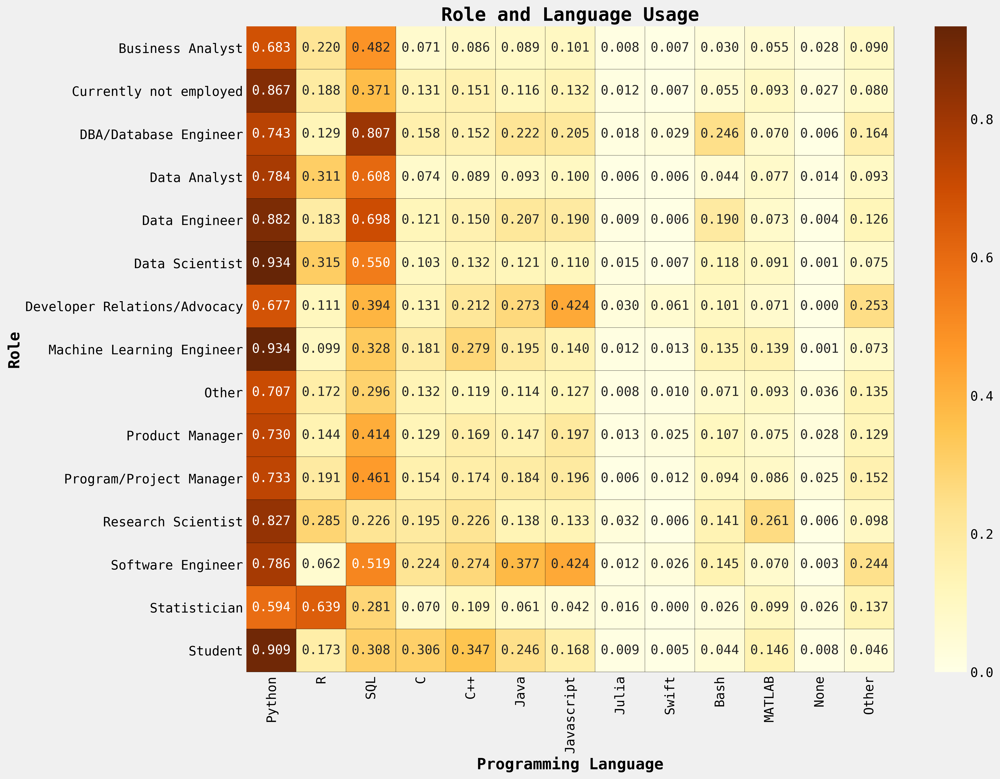

In [43]:
fig, ax = plt.subplots(figsize=(14, 12))
sns.heatmap(df2.groupby('Select the title most similar to your current role (or most recent title if retired):').mean().iloc[:,1:-2],
            xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":14}, fmt='.3f')
plt.title('Role and Language Usage', fontname = 'monospace', weight='bold')
plt.ylabel('Role', fontname = 'monospace', weight='semibold')
plt.xlabel('Programming Language', fontname = 'monospace', weight='semibold')
plt.show()

- In general -as we seen previous section- Python is popular with most of the roles. Especially popular among Data Scientists, Machine Learning Engineers and students.
- Looks like R commonly used by Statisticians,
- SQL has little bit more general usage but, we can see people who work in data pipelines like Database Engineers or Data Engineers it's much more common.
- It seems MATLAB mainly used by Research Scientists

# <div class="subsection_detail">2.3.2.2 Education vs. Language</div>

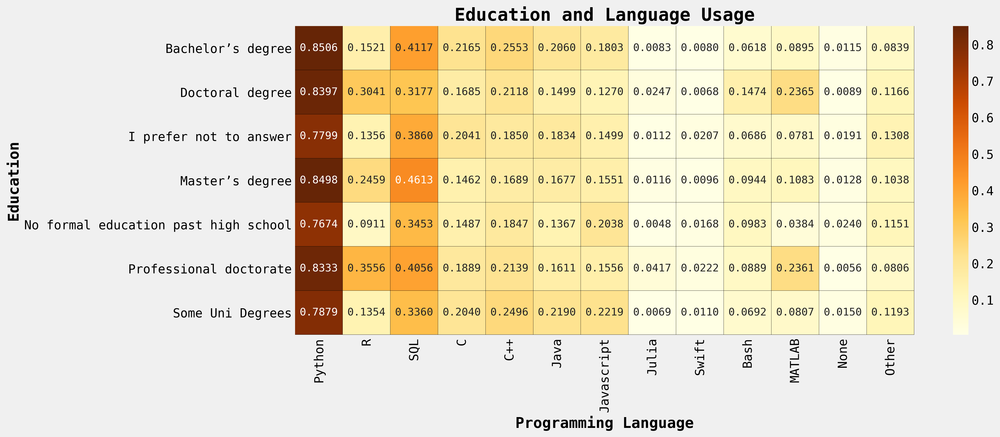

In [44]:
fig, ax = plt.subplots(figsize=(14, 6))
sns.heatmap(df2.groupby('What is the highest level of formal education that you have attained or plan to attain within the next 2 years?').mean().iloc[:,1:-2],
            xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Education and Language Usage', fontname = 'monospace', weight='bold')
plt.ylabel('Education', fontname = 'monospace', weight='semibold')
plt.xlabel('Programming Language', fontname = 'monospace', weight='semibold')
plt.show()

- We have similar look above, Python is most popular one with all education levels, SQL takes the second spot,
- It seems R is getting more popular with higher levels of education,
- I don't see significant differences for the rest of the programming languages maybe with exception: You can notice people where attended/planning doctorate have used MATLAB previously more common then other groups...


# <div class="subsection_title">2.3.3 Recommended Language to Learn First</div>

- Let's see what participants are recommending for an aspiring data scientist to learn first.

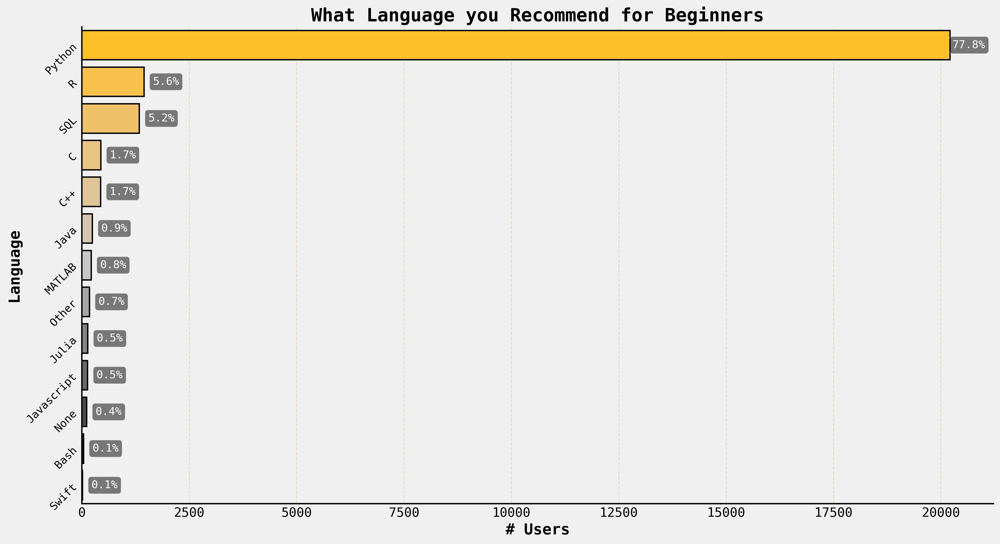

In [45]:
count_dist(df=df, colname='What programming language would you recommend an aspiring data scientist to learn first?',
           max_idx=30, fontsize=12, rotation=45,
           title='What Language you Recommend for Beginners', shift=820, y_label='Language'
          )

- Oh wow... Python is the real winner for the beginners. It got recommended almost 14x times more than it's closest follower which is R.
- But I wonder what are the people think after they actually use the language itself. Would they recommend it first again? Or the story changes after getting familiar with that language.


# <div class="subsection_detail">2.3.3.1 Recommending the Language by It's User</div>

Before we start;
- Please don't forget this recommendation is for aspiring Data Scientists and it's recommended for their first choice of programming language.
    - So we are not looking for general purpose language recommendation here,
    - Nor recommendations for experienced data scientists directly.
    - So for example, people who using C++ and not recommending their language are actually not recommending their own language for the beginner data scientists, not because they don't like it :)
    - Also people who are using C++ are likely been using other languages like Python too, since it's multi choice question...
- Well, with leaving the warnings behind let's take a look at the data itself :D

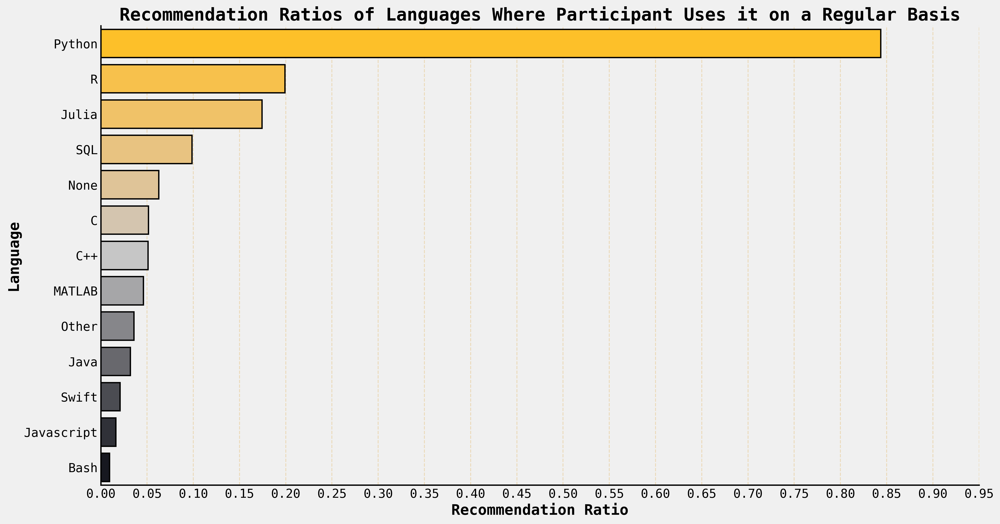

In [46]:
ratios = {}

for lan in languages:
    ratio = df2[df2[lan]==1]['What programming language would you recommend an aspiring data scientist to learn first?'].value_counts(normalize=True)
    ratios[lan]=ratio[lan]
recommendations=pd.DataFrame.from_dict(ratios, orient='index').reset_index().rename(columns={'index':'Used Language', 0:'Recommendation'}).sort_values(by='Recommendation', ascending=False)
ax=sns.barplot(y=recommendations['Used Language'], x=recommendations['Recommendation'], palette=cust_color, edgecolor='black', saturation = 1.5, linewidth= 1.5)
plt.ylabel('Language', fontname = 'monospace', weight='semibold')
plt.xlabel('Recommendation Ratio', fontname = 'monospace', weight='semibold')
plt.title('Recommendation Ratios of Languages Where Participant Uses it on a Regular Basis', fontname = 'monospace', weight='bold')
plt.xticks(np.arange(0, 1, 0.05))
plt.show()

- Hmm 84% of the participants who uses Python regularly recommends Python for aspiring data scientist to learn first.
- That makes Python most recommended by it's regular users by far.
- Closest one to this one is R, around 20%
- Julia also an interesting one, I think high performance makes it recommendable by it's users. Maybe with some more library support we might see increased numbers incoming years?
- We can already see Python is popular recommendation with all programming language users, so I just want to open new window for Python itself:
    - Who doesn't recommend Python?
    - What people recommend who uses Python but doesn't recommend it for beginners

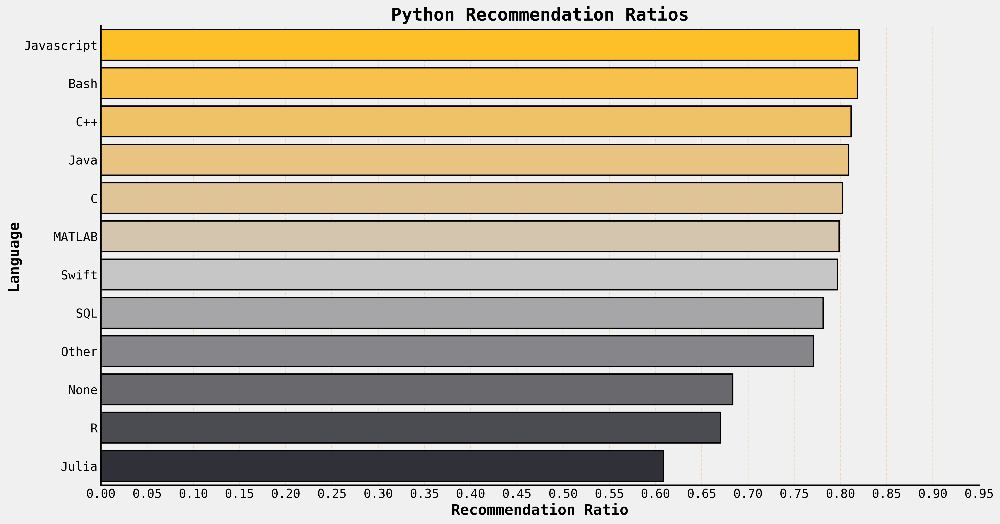

In [47]:
ratios = {}

for lan in languages:
    ratio = df2[df2[lan]==1]['What programming language would you recommend an aspiring data scientist to learn first?'].value_counts(normalize=True)
    ratios[lan]=ratio['Python']
recommendations=pd.DataFrame.from_dict(ratios, orient='index').reset_index().rename(columns={'index':'Used Language', 0:'Recommendation'}).sort_values(by='Recommendation', ascending=False)[1:]
ax=sns.barplot(y=recommendations['Used Language'], x=recommendations['Recommendation'], palette=cust_color, edgecolor='black', saturation = 1.5, linewidth= 1.5)
plt.ylabel('Language', fontname = 'monospace', weight='semibold')
plt.xlabel('Recommendation Ratio', fontname = 'monospace', weight='semibold')
plt.title('Python Recommendation Ratios', fontname = 'monospace', weight='bold')
plt.xticks(np.arange(0, 1, 0.05))
plt.show()

- It looks like love for Julia and R strong against Python.
- People who uses these two languages I mentioned above more likely to recommend you another beginner data science language than Python :)

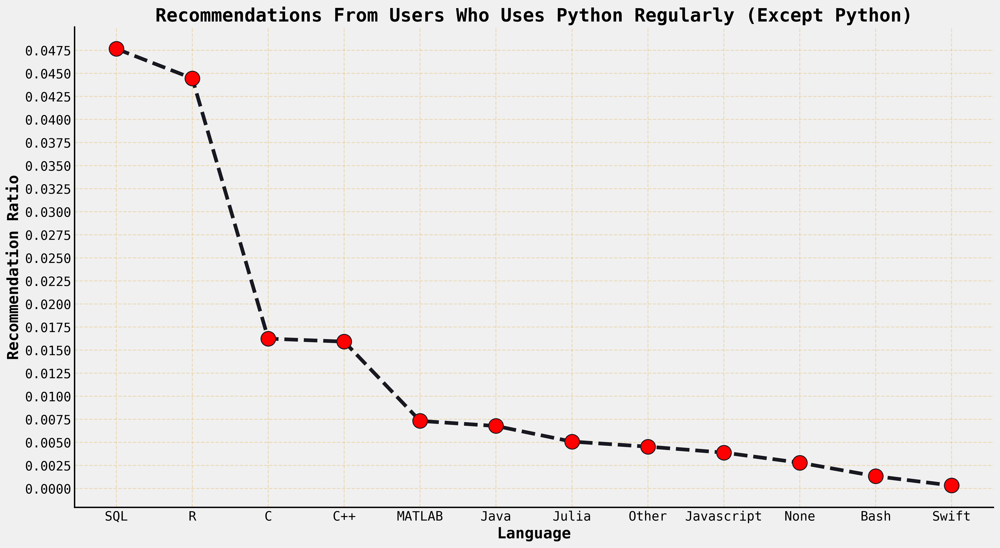

In [48]:
plt.plot(df2[df2['Python']==1]['What programming language would you recommend an aspiring data scientist to learn first?'].value_counts(normalize=True)[1:], color=cust_color[-1],
        linestyle='dashed', marker='o', markerfacecolor='red', markersize=16)
plt.xlabel('Language', fontname = 'monospace', weight='semibold')
plt.ylabel('Recommendation Ratio', fontname = 'monospace', weight='semibold')
plt.title("Recommendations From Users Who Uses Python Regularly (Except Python)", fontname = 'monospace', weight='bold')
plt.yticks(np.arange(0, 0.05, 0.0025))
plt.show()

- It's really small part of the users recommend other languages in this group (remember they mostly recommended Python), people who uses Python but doesn't recommend python are tend to recommend SQL (around %5) and R (around 5%) for aspiring data scientists.

# <div class="section_title">2.4 Work Platforms</div>

- In this chapter we're going see some stuff like development environments (IDE's), hosted notebook products, computing platforms, specialized hardwares, tensor processing units (TPU's)
- Some of them might not sound familiar to you, but don't worry, I'm going to give short describe about these terms quite soon.
- But basically in this chapter we're going to inspect which platforms (both software and hardware) participants using their daily data science / machine learning projects.
- Well, let's get the ball rolling then!

# <div class="subsection_title">2.4.1 IDE's</div>

- Here we're going to see some of the tools can make your life easier while coding.
- Each has it's own pro's and con's, usually there is no agreement among people about which one is best.
- In my opinion you should look at these as tools and choose the best fitting one.

In [49]:
ide_cols = [col.split('?')[-1].strip() for col in df.columns if "IDE's" in col]

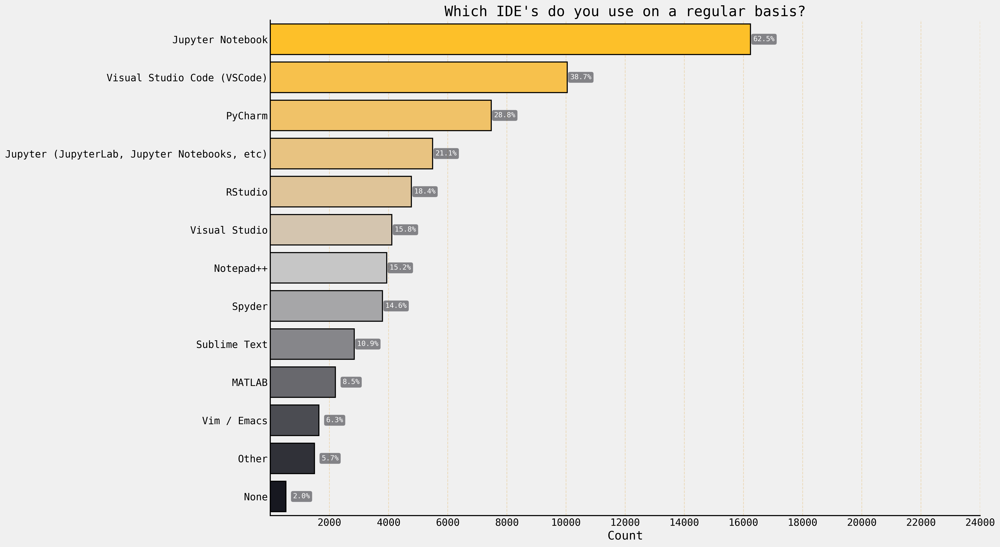

In [50]:
df3=one_hot_count(df=df, values=ide_cols, text="Which of the following integrated development environments (IDE's) do you use on a regular basis? ", colors=cust_color, shift_text=820, x_freq=2000,
                 title="Which IDE's do you use on a regular basis?")

- Looks like Jupyter products are the most popular one, they are easy to use and good for exploration and prototyping.
- Then comes VSCode and PyCharm, these are more for writing a production code, where you deploy your code to actual use or something.
- There might be some relations like "RStudio probably more popular among the R users", (thanks to the Captain Obvious), but let's see if there's an actual connection between languages and IDE's:

# <div class="subsection_detail">2.4.1.1 IDE vs Language</div>

- What we going to find about in next plot is whetever there is a correlation with IDE and user's programming language preference:

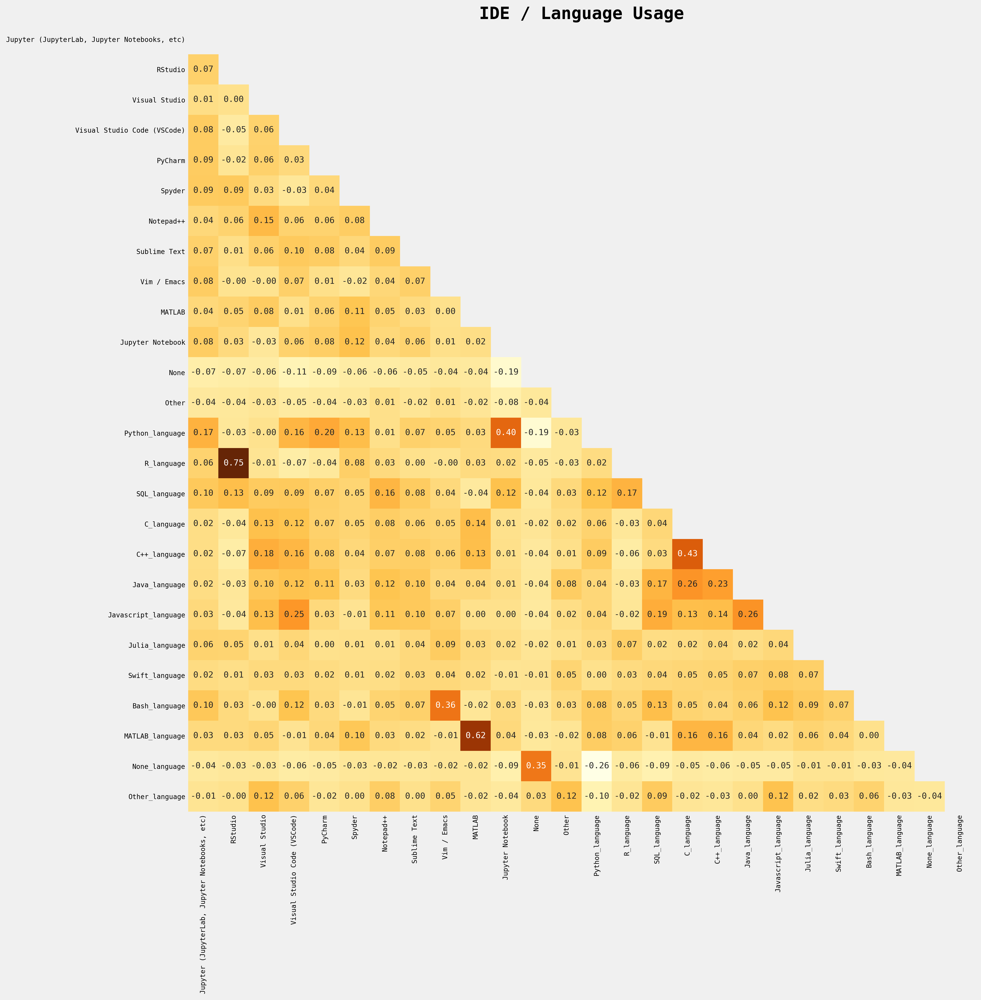

In [51]:
df4 = pd.concat([df3, df2[languages].add_suffix('_language')], axis=1)
correlation_train = df4[ide_cols+[lang+'_language'for lang in languages]].corr(method='kendall')
mask = np.triu(correlation_train.corr())
plt.figure(figsize=(16, 16))
sns.heatmap(correlation_train,
            annot=True,
            fmt='.2f',
            cmap='YlOrBr',
            square=True,
            mask=mask,
            
            cbar=False,
            annot_kws={"fontsize":10})

plt.xlabel('')
plt.ylabel('')
plt.title("IDE / Language Usage", fontname = 'monospace', weight='bold')
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)

plt.show()

- Interesting... Even sometimes it's hard to find meaningful correlations between categorical datas we can see some noticable correlations between some categories.
- The most obvious one is between R and RStudio,
- With MATLAB and MATLAB IDE there we can notice similar correlation
- There's noticeable correlation between Python and Jupyter Notebooks
- Vim / Emacs has some degree of correlation with Bash 
- While looking at this table we can also see some kind of clusters between some languages like: Java, Javascript, C, C++, it shows when a participant uses one of these languages regularly there is a stronger chance than rest to use one of the other languages from this cluster...

# <div class="subsection_title">2.4.2 Notebooks</div>

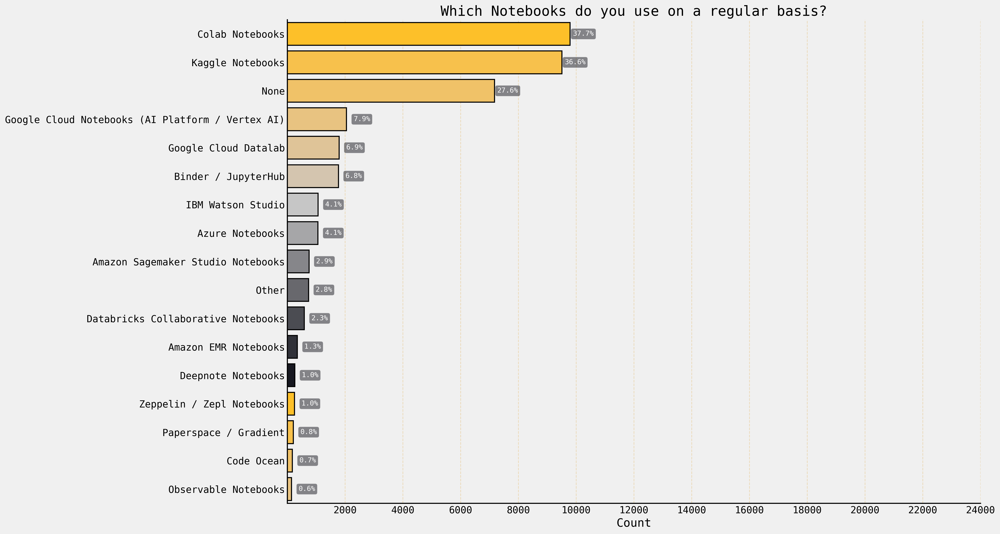

In [52]:
notebook_cols = [col.split('?')[-1].strip() for col in df.columns if "notebook products" in col]

df5=one_hot_count(df=df, values=notebook_cols, text="Which of the following hosted notebook products do you use on a regular basis? ", colors=cust_color, shift_text=820, x_freq=2000,
                 title="Which Notebooks do you use on a regular basis?")

- Colab and Kaggle notebooks are the leaders here. 
- We also have significant amount of people who doesn't prefer notebooks too.
- It comes back to topic we discussed before, it's important to decide what tool you going to use depending on your project before you start it...

# <div class="top_section">It Was All Connected! Was it?..</div>


<img src="https://i.kym-cdn.com/entries/icons/original/000/022/524/tumblr_o16n2kBlpX1ta3qyvo1_1280.jpg" style="height: 180; width: 100%; object-fit: cover;"/>

[Source: Know Your Meme](https://knowyourmeme.com/memes/pepe-silvia)

- So, in previous chapters we went over somewhat more general attributes of a kaggle user. I went with a hypothesis that almost all participants are somewhat interested with programming and with data itself to some degree. As we seen, it's almost true...

- We have seen some strong, some weak connections but at the end we found relationships between all variables.
- But what are we after here? Where all these connections lead to?
- I mean we can find direct connections between two or more features but what do they mean in general picture?
- I believe we can find some key features that many of subfeatures might lead to, like:
    - Role
    - Salary
    - Education
- Or maybe something else, we don't know yet but that's what we are trying to find.
- I'm hoping we gonna find answers for these questions in next chapters with the help of data our story gonna unfold. Were they all connected? I don't know, but I hope so. Let's get going to find it!
- But before doing that, let's get working on something else too:

# <div class="section_title">Story of Robert</div>

- So we inspected and searched for relationships between demographics, background, some general programming knowledge and preference of working environment.
- While doing so we learned a lot about an average kaggle user:
    - Demographics of a participant like, age, gender, place of residence.
    - Educational background, what's the highest level of education or plans for next two years, courses attended etc.
    - Actual role of a participant, we learned about if a participant is currently unemployed, studying or working, if so what's the title.
    - Coding related information like, coding experience in years, programming language usage, recommendations for beginners etc.
    - Working environment info, which IDE a participant uses regularly, choice of notebook platform of a given kaggle user.
    
With all of these info I believe we can create an "Average Joe" of kaggle if we randomly select some of the popular features. Well let's create one then! We can call him "Robert", why not?
### **The Story of our little Robert would be something like this:**

*Robert is a 24 year old male from USA, he got his Bachelor's degree recently and planning to attend Master's program incoming years. He still identifies himself as a student. He's been interested in programming and data science lately but didn't have formal education to get to know about these in school. So he decided to learn programming from online courses on his own. He found out Python is very popular for Data Science and he started studying it. After couple months of courses (1< years of experience) he feels competent enough to look at Data Science stuff using Python. He jumps on kaggle to play with toy datasets like Titanic, Housing Prices etc. He gets more familiar to work on kaggle (jupyter) notebooks but with all of the new stuff about data science pouring over him like Data Analysis, Machine Learning, Deep Learning Frameworks, Algorithms, CV/NLP, he gets little bit overwhelmed and lost... He doesn't know what to study and in which order he should start learning. Even he learns about some stuff, he still gets confused about his future job, is he going to be a Data Analyst? Data Scientist? Or Machine Learning Engineer? Or something else... He doesn't know, they all seem similar to him and with his background/skills he doesn't know which role he perfectly fits. What is going to be his daily work responsibilities, what does he needs to know to fulfill his duties, what does he needs to learn to advance in his career. Will his salary going to be satisfying for him, or did he make a mistake by choosing Data Science field? What if he made a bad decision, or he's going to make one? Robert gets stressed and confused lately... Maybe with help of the data itself we can help poor little Robert, shall we?*

# <div class="section_title">2.5 Time to Specialize</div>

- In this chapter we're going take a closer look to the needs of data related roles, what libraries, frameworks, algorithms etc. you need to learn to seperate you from others who already can code.
- What makes you a data specialist? What are the tools people have using for this purpose? What are the tools which has more general use while which ones are for more specific for specialized roles.

*It's going to be really useful chapter for Robert, he has been really confused with what to learn next and learning what people are using regularly might help him. If we can connect these with specific career path it going to be even more helpful! Lucky you Robert, things are getting better for you! :)*

# <div class="subsection_title">2.5.1 Visualization Libraries</div>

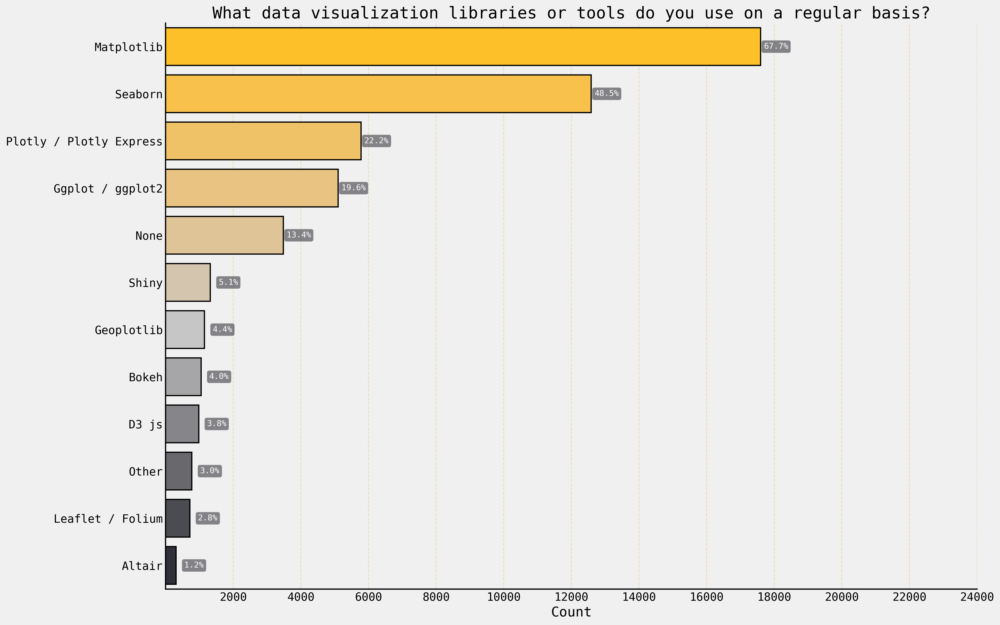

In [53]:
visualization_cols = [col.split('?')[-1].strip() for col in df.columns if "visualization" in col]
df6=one_hot_count(df=df, values=visualization_cols, text="What data visualization libraries or tools do you use on a regular basis? ", colors=cust_color, shift_text=820, x_freq=2000,
                 title="What data visualization libraries or tools do you use on a regular basis?")

# <div class="subsection_detail">2.5.1.1 Visualization Libraries and Languages</div>

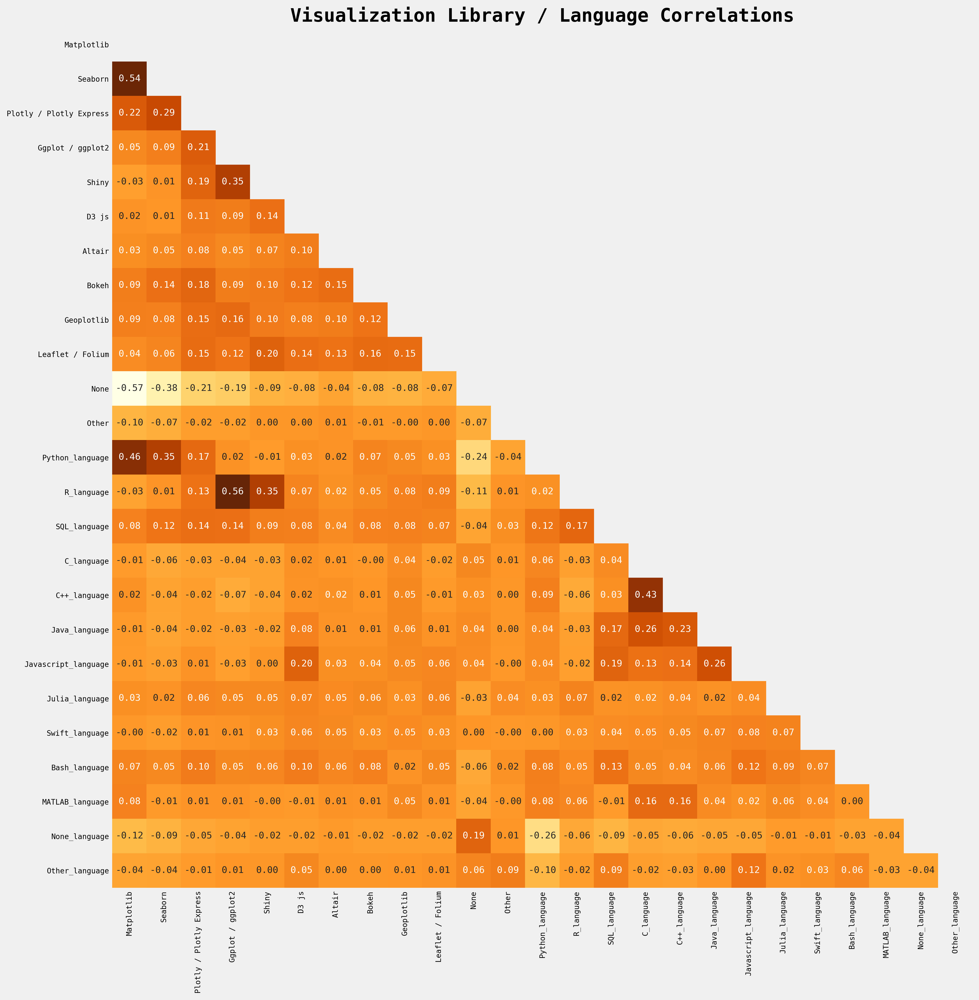

In [54]:
df6 = pd.concat([df6, df2[languages].add_suffix('_language')], axis=1)
correlation_train = df6[visualization_cols+[lang+'_language'for lang in languages]].corr(method='kendall')
mask = np.triu(correlation_train.corr())
plt.figure(figsize=(16, 16))
sns.heatmap(correlation_train,
            annot=True,
            fmt='.2f',
            cmap='YlOrBr',
            square=True,
            mask=mask,
            
            cbar=False,
            annot_kws={"fontsize":10})

plt.xlabel('')
plt.ylabel('')
plt.title("Visualization Library / Language Correlations", fontname = 'monospace', weight='bold')
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)

plt.show()

- I see some decent correlations here, most obvious one is Ggplot / ggplot2 and R correlation, well it was expected, right? I know some people are using R just for ggplot...
- Seaborn & Matplotlib are closely related, well one built over the other one anyways...
- With Python most correlated ones are these two I mentioned above, followed by Plotly which gets really popular lately.

*For Robert we can suggest taking a closer look to Seaborn & Matplotlib, since he feels competent with Python. We still don't know if he is going to like data visualization but still knowing little bit of visualization could help a lot in his other tasks too. I can also recommend Plotly to Robert if he's interested in visualization more, lately I'm seeing lots of cool plots created with them around here :)*

# <div class="subsection_detail">2.5.1.2 Visualization Libraries and Roles</div>

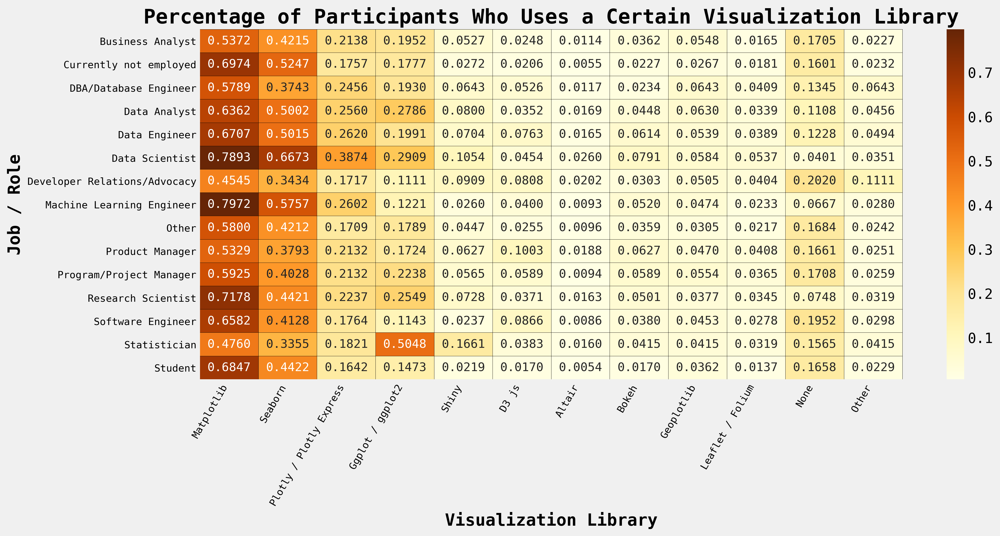

In [55]:
fig, ax = plt.subplots(figsize=(14, 6))
sns.heatmap(df6.groupby('Select the title most similar to your current role (or most recent title if retired):')[visualization_cols].mean(),
            xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":12}, fmt='.4f')
plt.title('Percentage of Participants Who Uses a Certain Visualization Library', fontname = 'monospace', weight='bold')
plt.ylabel('Job / Role', fontname = 'monospace', weight='semibold')
plt.xlabel('Visualization Library', fontname = 'monospace', weight='semibold')
plt.xticks(rotation=60, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.show()

- Whatever your job/role is you probably used Matplotlib. The table above shows around 60% of the participants uses that library regularly.
- Statisticians are using ggplot more often, we can see Statistician, R and ggplot relation here easily.
- Machine Learning Engineers using Matplotlib mainly even more than Data Scientist. It's easy to use and get results in a fast fashion, meanwhile seaborn and plotly a little bit more popular for Data Scientists probably for the people whoo needs to present their findings in better shape :)

*Well Robert, I know you are confused and still not sure what data oriented career path you should choose in future but you must know about at least one visualization library. As you can see it doesn't matter if you going to be Data Analyst or Machine Learning Engineer, you need to visualize your findings and use/present them in your job. We already suggested which ones to start learning first but these findings are strengthening the idea.*

# <div class="subsection_title">2.5.2 Machine Learning Frameworks</div>

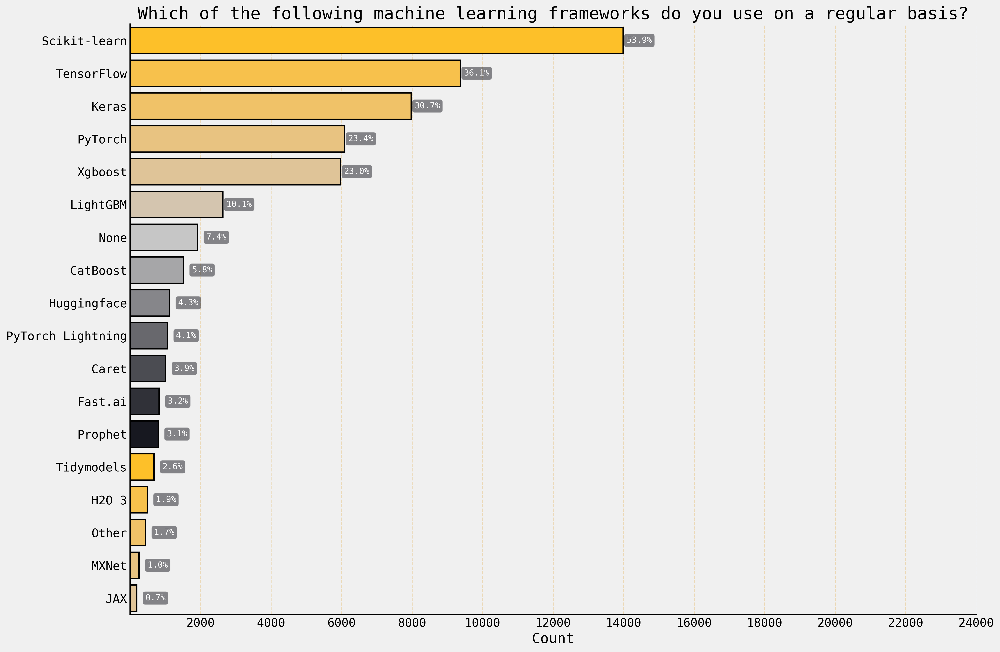

In [56]:
ml_cols = [col.split('?')[-1].strip() for col in df.columns if "machine learning frameworks" in col]
df7=one_hot_count(df=df, values=ml_cols, text="Which of the following machine learning frameworks do you use on a regular basis? ", colors=cust_color, shift_text=820, x_freq=2000,
                 title="Which of the following machine learning frameworks do you use on a regular basis?")

- Things are getting more complicated here :)
- With ML libraries/frameworks are entering the picture, even the clear winner barely passes the 50% limit which is Scikit-learn.
- Since I have use most of these on regular basis I might add some personal notes about them:
    - Scikit-learn is a library provides many learning algorithms, setting standard for many other ML libraries. It's great tool to do prototyping, I forgot how many times I started prototyping a solution for a problem and at the end found out sklearn is more than enough...
    - Tensorflow is a library for fast numerical computings which we need them for Deep Learning. It's has low level abilities to customize our workflow as we want.
    - Keras is higher level API for tensorflow, it wraps most common deep learning tasks aiming for easier usage. (You can still do low level stuff though)
    - JAX is relatively a young framework, it's designed for high-performance numerical computing. People like to call it "NumPy on steroids" :)
    - Pytorch is between these two above, again it's an open source ML library for mainly deep learning tasks. People usually say it has more "Pythonic" style...
    - You can think PyTorch Lightning like a Keras for Pytorch, not exactly same but it's aiming for similar purposes.
    - Xgboost, LightGBM and Catboost are similar libraries, aiming to get maximum use of gradient boosting. They do well on tabular data usually...
    - You can also see some libraries has more specific usage areas like Huggingface for Natural Language Processing tasks or Prophet for time series etc.

# <div class="subsection_detail">2.5.2.1 Machine Learning Libraries and Roles</div>

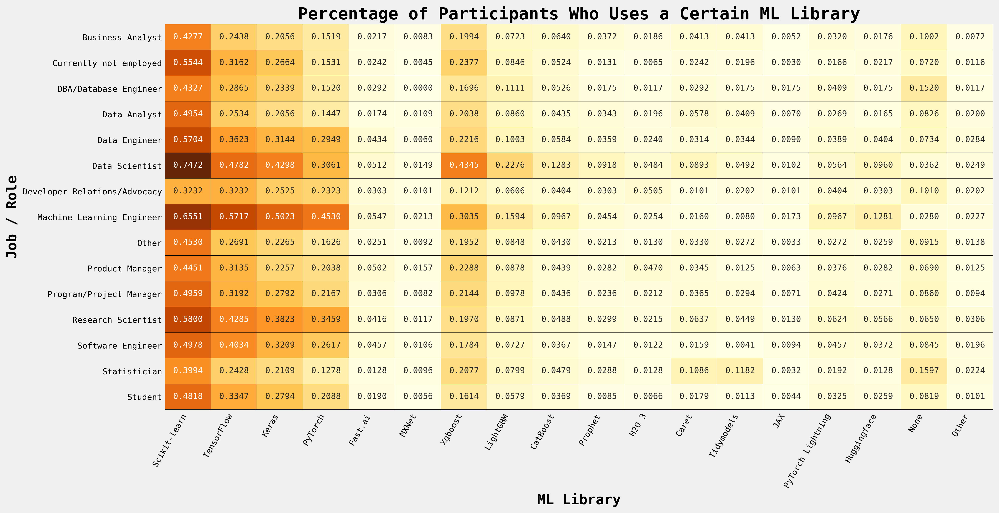

In [57]:
fig, ax = plt.subplots(figsize=(16, 8))
sns.heatmap(df7.groupby('Select the title most similar to your current role (or most recent title if retired):')[ml_cols].mean(),
            xticklabels=True, yticklabels=True, cmap='YlOrBr', annot=True, linewidths=0.005, linecolor='black', annot_kws={"fontsize":10}, fmt='.4f', cbar=False)
plt.title('Percentage of Participants Who Uses a Certain ML Library', fontname = 'monospace', weight='bold')
plt.ylabel('Job / Role', fontname = 'monospace', weight='semibold')
plt.xlabel('ML Library', fontname = 'monospace', weight='semibold')
plt.xticks(rotation=60, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.show()

- Scikit-learn seems to have wide variety users, doesn't matter what role you have it's still has some use cases for you. It has pretty common usage with Data Scientists and Machine Learning Engineers.
- When we switch to Deep Learning Frameworks like TensorFlow, Keras, PyTorch, we see Machine Learning Engineers are getting one step ahead, while most roles seen decrease from sklearn to these frameworks, one of the most limited decrease is from ML Engineers. Followed by Research Scientists and Sofware Engineers (Interesting one)...
- Gradient boosting algorithms are more common than other role groups among Data Scientists.
- It seems statisticians are one of the least interested groups in machine learning (after Developer Relations), I was expecting little big jump at Tidymodels for this group but it seems even "None" group had sharper spike.

*So Robert... I heard you getting interested specially in Data Scientist and Machine Learning Engineer roles. You better start learning Scikit-learn then, as you can see it's really popular and in demand. Also, like I mentioned above it has great workflow standard so after getting familiar with it you can learn other libraries much faster. For example some popular libraries like Xgboost, LightGBM already having sklearn interface too, so after getting familiar with sklearn you can start using these too in no time! Good lad! If you want to advance further I'd suggest taking a look at the TensorFlow and especially Keras, because of it's higher level API and having some similarities with sklearn workflow it would be good starting point. To get little bit of theory and practical knowledge you can get help of books. For Scikit-learn I'd recommend "Introduction to Machine Learning with Python: A Guide for Data Scientists" from 
Andreas C. Müller, for TensorFlow and Keras you can take a look at "Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow" from Aurélien Géron, in that book you can get some solid knowledge for sklearn too. If you want something Keras specific you can read "Deep Learning with Python" from François Chollet. Getting familiar with these going to take some time but after that you can start learning PyTorch if you like to, it's a great framework and lately on the rise, many research codes are published in PyTorch format so it's nice to know. Hey Robert! Are you still there?!*

# <div class="subsection_detail">2.5.2.2 Machine Learning Libraries and Roles</div>
- So, couple sections above we have seen visualization libraries are pretty popular among Machine Learning practicioners, let's see how these relations connects with ML frameworks themselves.

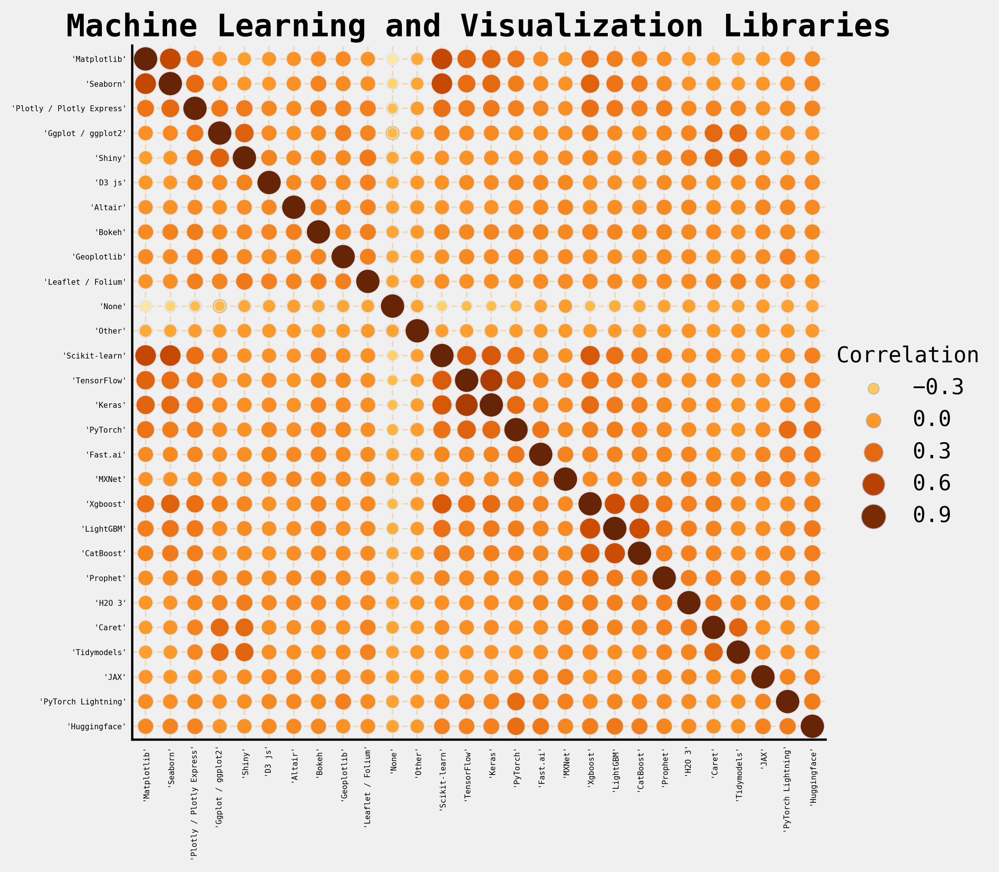

In [58]:
df7 = pd.concat([df7, df6[visualization_cols]], axis=1)
z= df7[visualization_cols+ml_cols]
corr_mat = z.corr().stack()
z=pd.DataFrame(data=corr_mat.values, index=corr_mat.index.to_flat_index(), columns=['Correlation']).reset_index()
z['index'] = z['index'].astype('str')
z['index'] = z['index'].str.replace('(','', regex=False)
z['index'] = z['index'].str.replace(')','', regex=False)
z[['level_0','level_1']] = z['index'].str.split(', ',expand=True)

g = sns.relplot(
    data=z,
    x="level_0", y="level_1", hue="Correlation", size="Correlation",
    palette="YlOrBr", hue_norm=(-1, 1), edgecolor=".9",
    height=10, sizes=(50, 250), size_norm=(-.2, .8),
)

g.set(xlabel="", ylabel="", aspect="equal")
g.ax.margins(.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(90)
for artist in g.legend.legendHandles:
    artist.set_edgecolor(".7")
plt.xticks(fontsize=5)
plt.yticks(fontsize=5)
plt.title('Machine Learning and Visualization Libraries', fontname = 'monospace', weight='bold')
plt.show()

- Most popular visualization tools (Matplotlib, Seaborn) are highly related with Scikit-learn, followed by Keras/TF and XGboost.
- ggplot and Shiny are more correlated with Tidymodels and Caret, again strong R connections :)
- For the rest of visualization libraries I couldn't find meaningful correlations between them and ML libraries, so let's check relations between ML libraries themselves.
- You can notice decent correlation between sklearn and gradient boosting algorithms and TF/Keras, so in some ways that confirms our suggestion to learn Scikit-learn first.
- For PyTorch strongest ones are Pytorch Lightning (Suprise!) and Huggingface, you can use Tensorflow with Huggingface too but PyTorch seems more default setting for it. Again TF/Keras has some correlation with PyTorch too since they both serve for Deep Learning...

# <div class="section_title">To be Continued...</div>

### This notebook is still work in progress, I'm going to update it whenever I get free time...

### Anyways thanks for reading! I hope you liked it, please don't forget to upvote if you did!

### Happy Kaggling!!!